<br></br>
<h3>Gender Model:</h3>

In [459]:
import os
import numpy as np
import matplotlib.pyplot as plt
from keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array, load_img
from lime import lime_image
from tensorflow.keras.applications.inception_v3 import preprocess_input
from skimage.segmentation import mark_boundaries
import cv2

<br></br>
<h3>Loading the model:</h3>

In [128]:
model_path = './face_classification/trained_models/gender_models/simple_CNN.81-0.96.hdf5'
gender_model = load_model(model_path)

In [129]:
gender_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_array (Conv2D)        (None, 48, 48, 16)        2368      
                                                                 
 batch_normalization_1 (Batc  (None, 48, 48, 16)       64        
 hNormalization)                                                 
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 16)        12560     
                                                                 
 batch_normalization_2 (Batc  (None, 48, 48, 16)       64        
 hNormalization)                                                 
                                                                 
 activation_1 (Activation)   (None, 48, 48, 16)        0         
                                                                 
 average_pooling2d_1 (Averag  (None, 24, 24, 16)      

In [130]:
gender_labels = {0: "Female", 1: "Male"}

In [474]:
# Function to preprocess the image
def preprocess_image_for_model(img):
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    return x

<h3>Load and Display:</h3>

In [463]:
def load_and_display_images(folder):
    images = {}
    for filename in os.listdir(folder):
        img_path = os.path.join(folder, filename)
        img = load_img(img_path)
        images[filename] = img
        plt.figure(figsize=(5, 5))
        plt.imshow(img)
        plt.title(filename)
        plt.axis('off')
        plt.show()
    return images

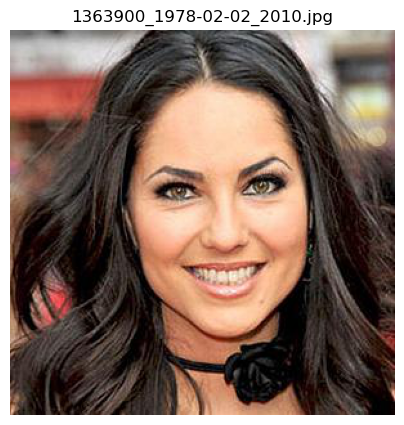

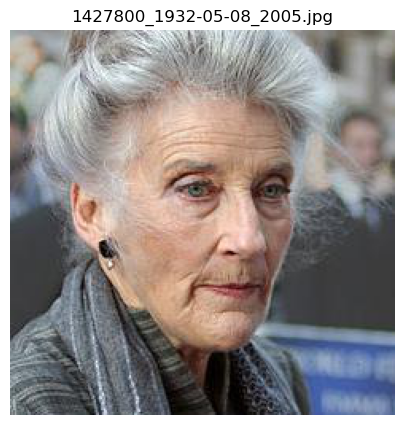

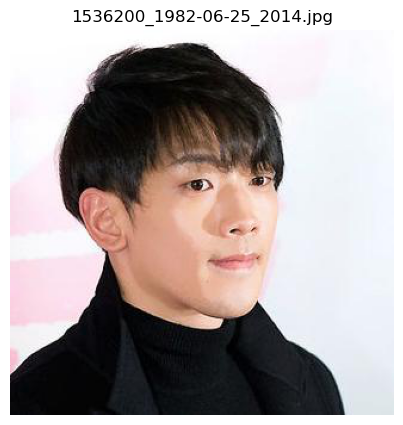

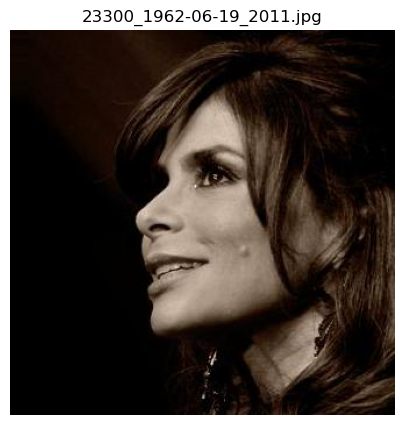

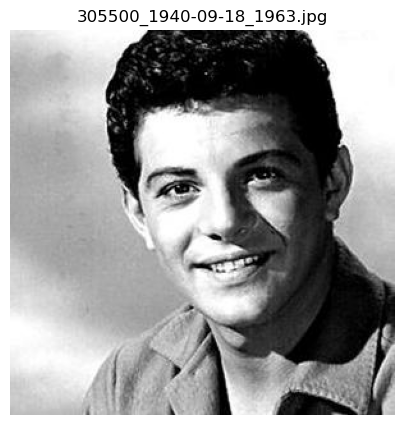

...

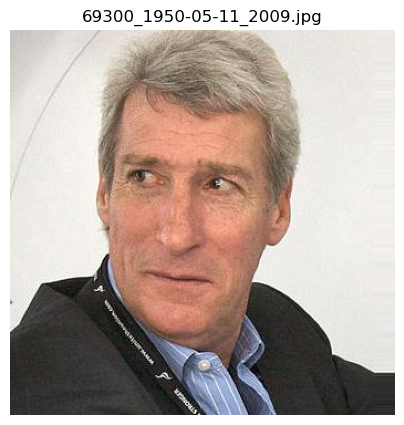

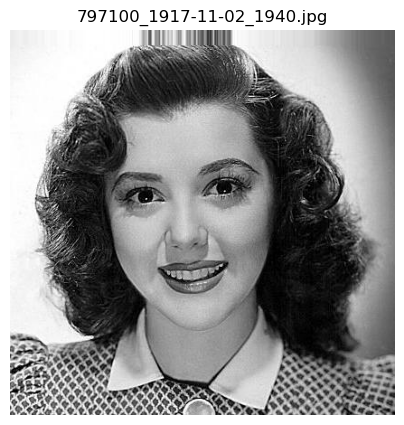

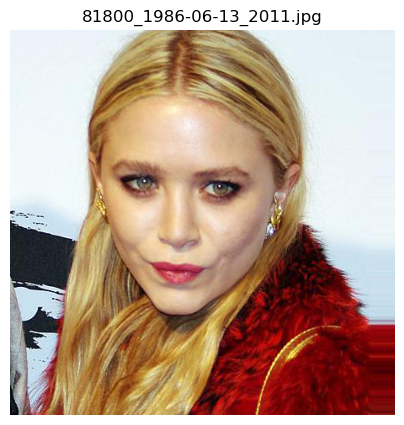

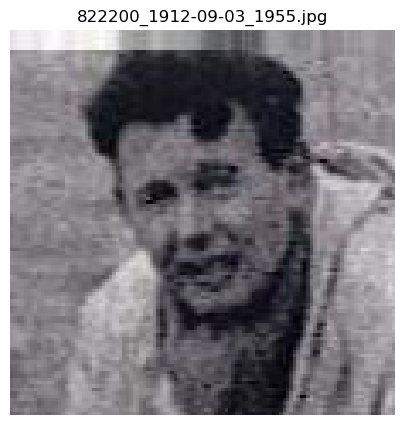

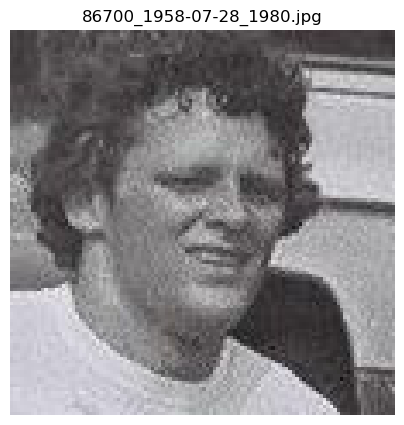

In [146]:
# Load images from the folder
folder_path = './face_classification/datasets/wiki_crop/images_lime/'
images = load_and_display_images(folder_path)

<h3>Preprocessing:</h3>

<h3>Predict and Display Images with Confidence:</h3>

In [149]:
def predict_and_display(model, images):
    for filename, img in images.items():
        preprocessed_img = cv2.resize(np.array(img), (48, 48))
        preprocessed_img = preprocess_image_for_model(preprocessed_img)
        predictions = model.predict(preprocessed_img)
        predicted_class = np.argmax(predictions, axis=1)[0]
        print("Predicted_calss", predicted_class)
        confidence = predictions[0][predicted_class]
        predicted_label = gender_labels[predicted_class]
        plt.figure(figsize=(5, 5))
        plt.imshow(img)
        plt.title(f'{filename}\nPredicted: {predicted_label} ({confidence:.2f})')
        plt.axis('off')
        plt.show()

1/1 [==============================] - 0s 475ms/step
Predicted_calss 0


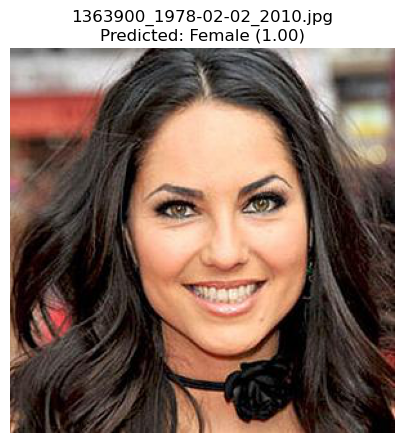

1/1 [==============================] - 0s 50ms/step
Predicted_calss 0


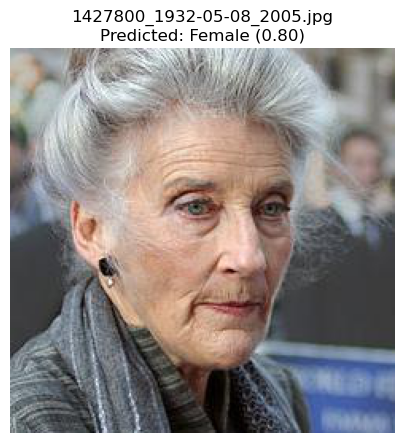

1/1 [==============================] - 0s 58ms/step
Predicted_calss 1


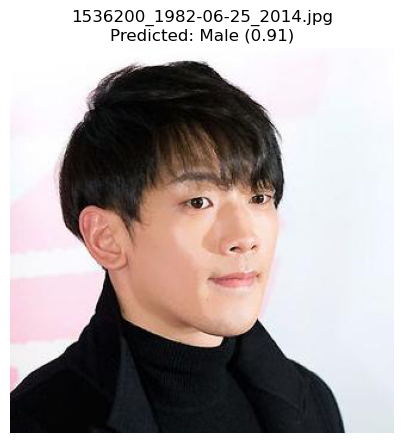

1/1 [==============================] - 0s 66ms/step
Predicted_calss 0


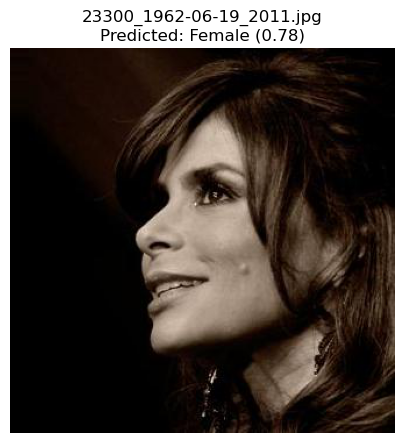

1/1 [==============================] - 0s 50ms/step
Predicted_calss 1


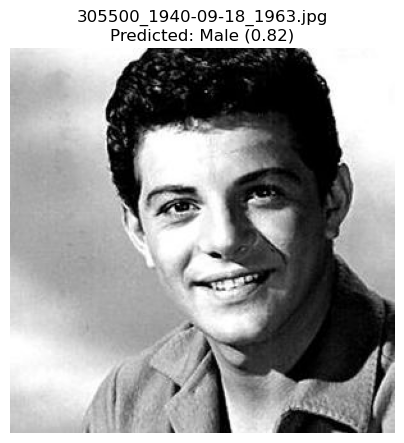

1/1 [==============================] - 0s 51ms/step
Predicted_calss 1


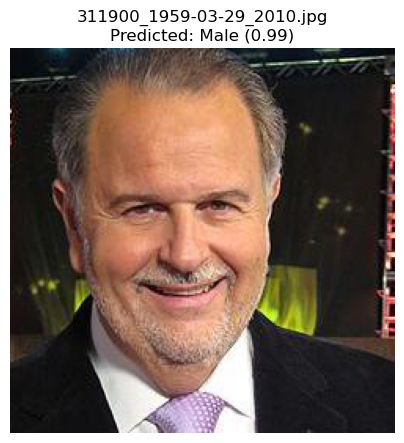

1/1 [==============================] - 0s 54ms/step
Predicted_calss 0


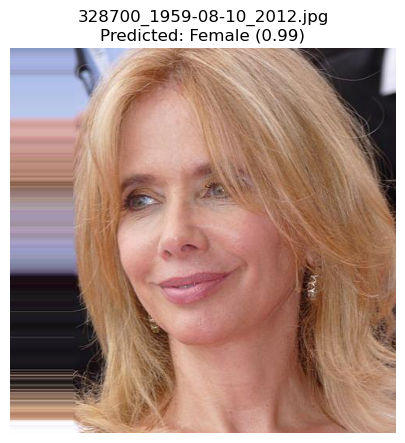

1/1 [==============================] - 0s 51ms/step
Predicted_calss 0


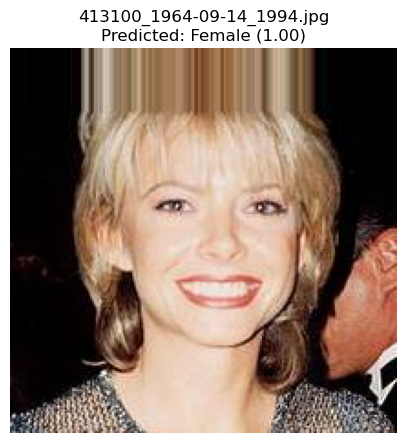

1/1 [==============================] - 0s 59ms/step
Predicted_calss 1


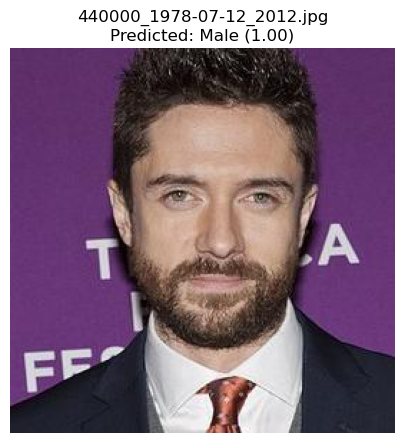

1/1 [==============================] - 0s 57ms/step
Predicted_calss 0


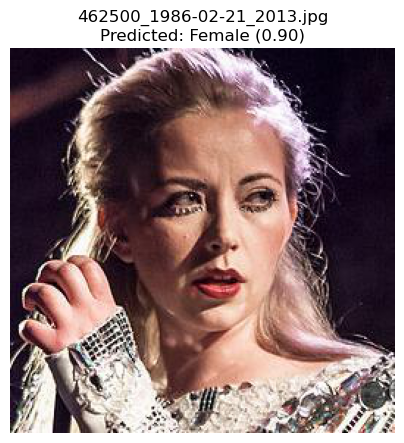

1/1 [==============================] - 0s 44ms/step
Predicted_calss 1


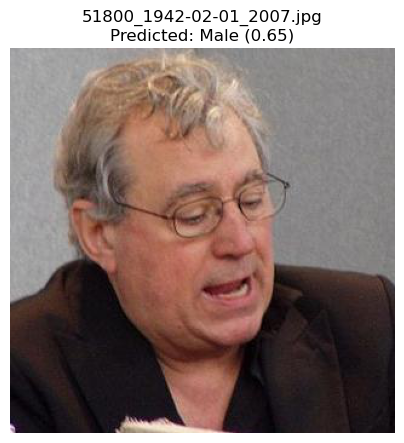

1/1 [==============================] - 0s 49ms/step
Predicted_calss 0


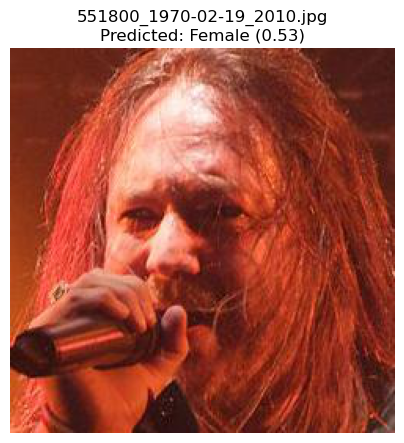

1/1 [==============================] - 0s 48ms/step
Predicted_calss 1


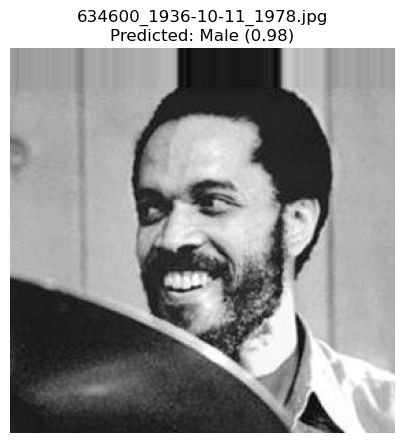

1/1 [==============================] - 0s 56ms/step
Predicted_calss 0


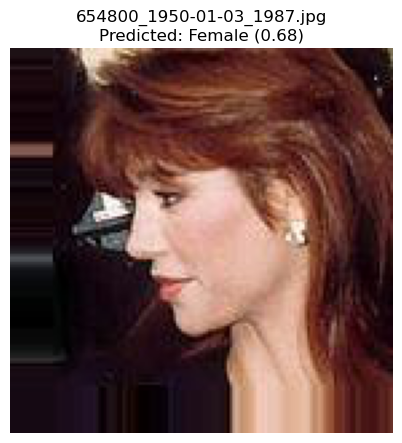

1/1 [==============================] - 0s 57ms/step
Predicted_calss 1


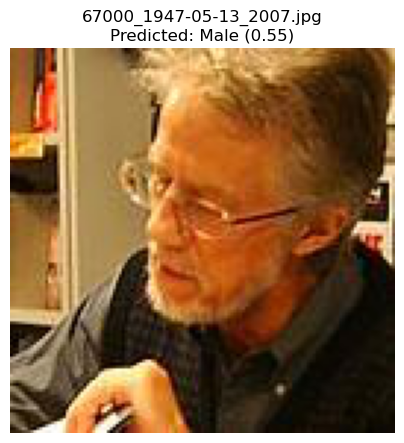

1/1 [==============================] - 0s 52ms/step
Predicted_calss 1


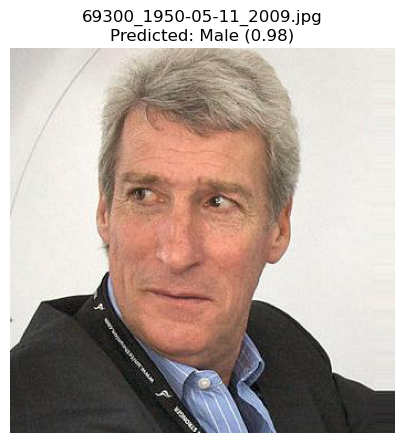

1/1 [==============================] - 0s 53ms/step
Predicted_calss 0


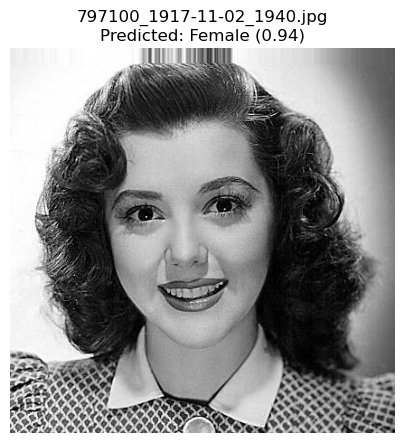

1/1 [==============================] - 0s 47ms/step
Predicted_calss 0


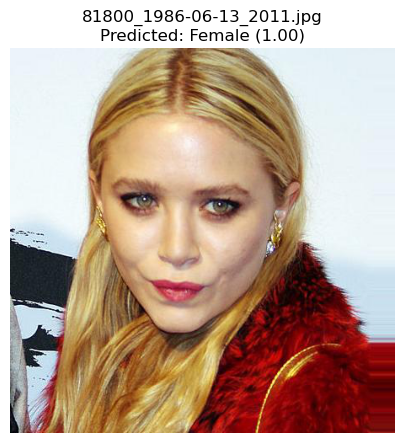

1/1 [==============================] - 0s 50ms/step
Predicted_calss 1


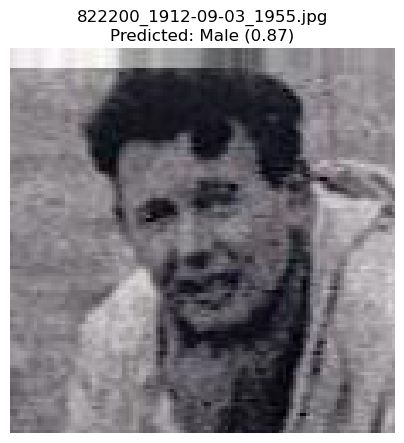

1/1 [==============================] - 0s 46ms/step
Predicted_calss 1


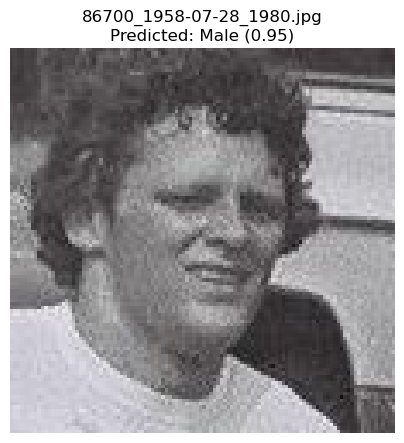

In [150]:
predict_and_display(gender_model, images)

<h3>Get the Explanations with Lime:</h3>

In [158]:
def explain_with_lime(img, filename, model, num_samples=500):
    explainer = lime_image.LimeImageExplainer()

    # Resize for model prediction
    model_size = (48, 48)
    model_img = cv2.resize(np.array(img), model_size, interpolation=cv2.INTER_AREA)
    preprocessed_model_img = preprocess_image_for_model(model_img)

    # Get the model's prediction first
    prediction = model.predict(preprocessed_model_img)
    predicted_class = np.argmax(prediction, axis=1)[0]

    # Resize for LIME visualization
    lime_size = (192, 192)
    lime_img = cv2.resize(np.array(img), lime_size, interpolation=cv2.INTER_LANCZOS4)
    preprocessed_lime_img = preprocess_image_for_model(lime_img)

    # Now use LIME to explain this prediction on the upscaled image
    explanation = explainer.explain_instance(preprocessed_lime_img[0].astype('double'), 
                                             model.predict, 
                                             top_labels=2, 
                                             hide_color=0, 
                                             num_samples=num_samples)

    print("Segments")
    plt.figure(figsize=(2, 2), dpi=200)
    plt.imshow(explanation.segments)
    plt.show()

    # Use the predicted class for the explanation
    label = predicted_class
    print("Label used for explanation:", label)
    
    a = explanation.get_image_and_mask(label=label)
    print(a[0].shape, a[1].shape)
    plt.imshow(a[0])
    plt.show()
    plt.imshow(a[1])
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only=True, num_features=5, hide_rest=False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only=False, num_features=5, hide_rest=False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()
    
    ind = label
    dict_heatmap = dict(explanation.local_exp[ind])
    heatmap = np.vectorize(dict_heatmap.get)(explanation.segments)

    # Plotting the visualization
    plt.imshow(heatmap, cmap="RdBu", vmin=-heatmap.max(), vmax=heatmap.max())
    plt.colorbar()
    plt.show()

1/1 [==============================] - 0s 64ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 470ms/step
Segments


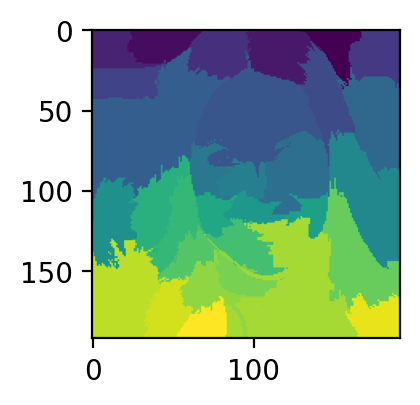

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


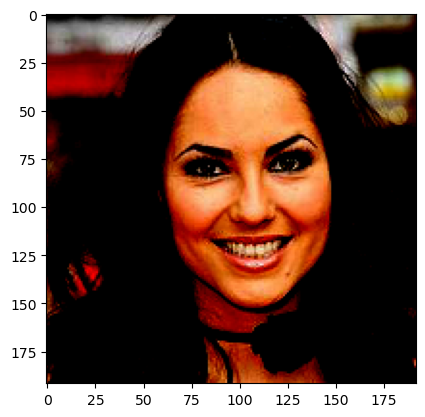

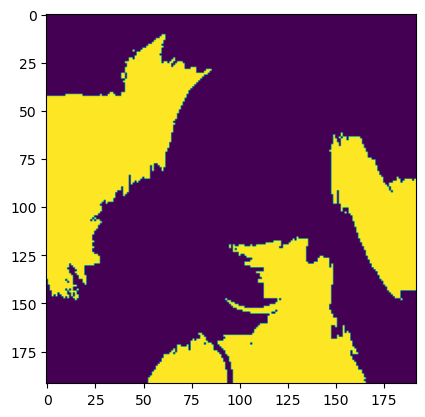

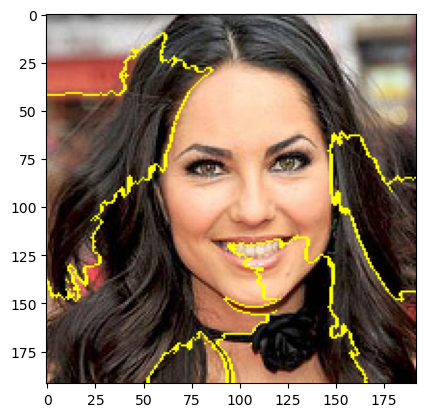

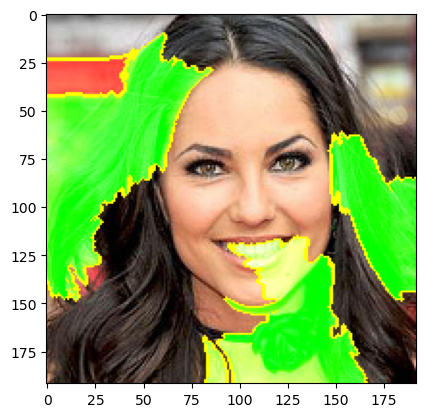

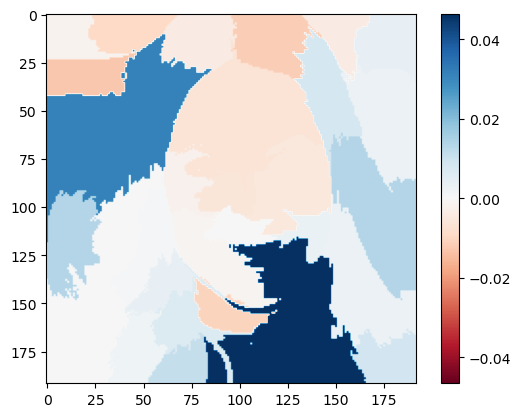

1/1 [==============================] - 0s 57ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 478ms/step
Segments


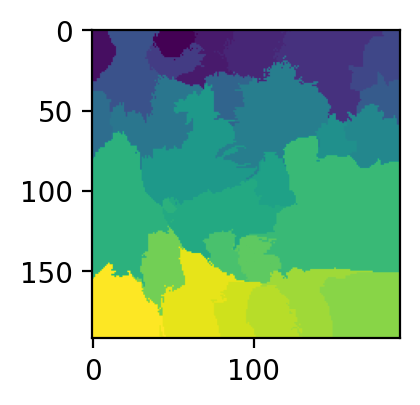

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


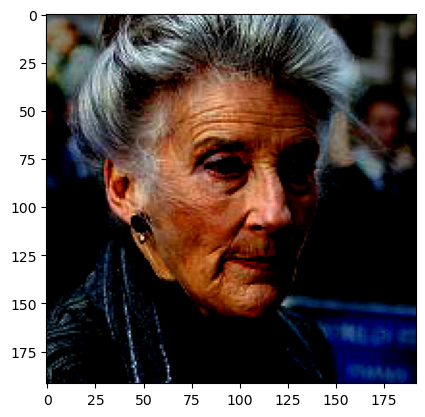

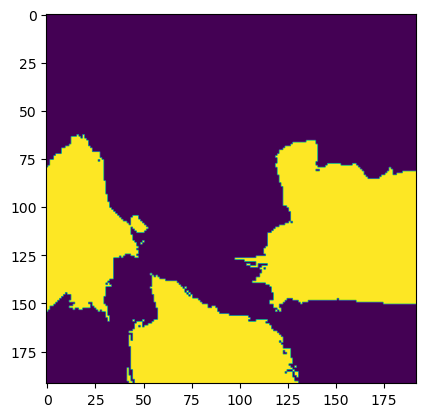

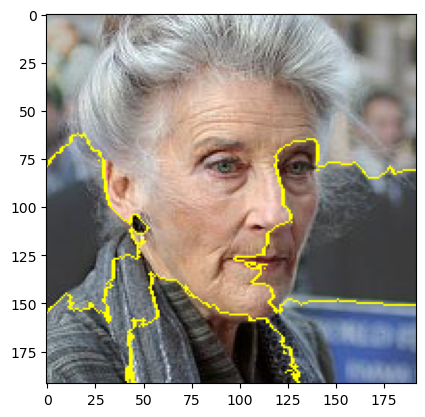

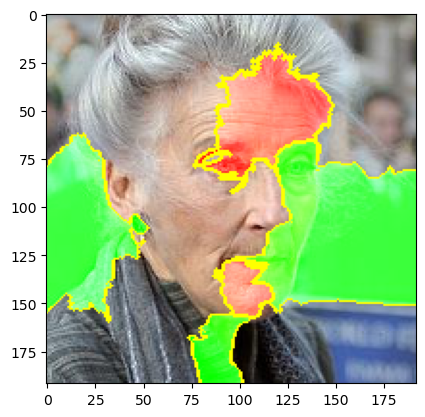

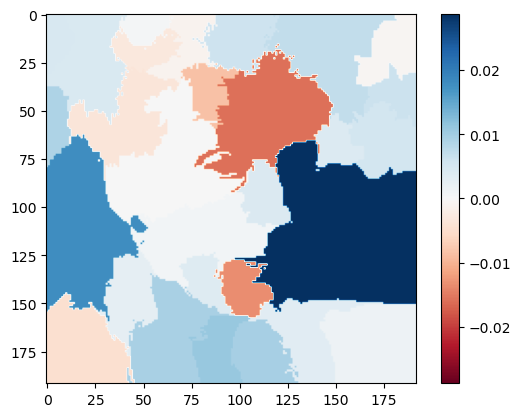

1/1 [==============================] - 0s 56ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 459ms/step
Segments


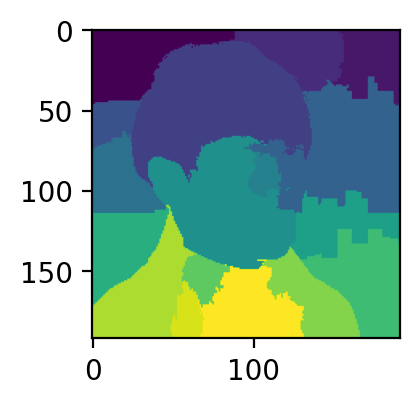

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


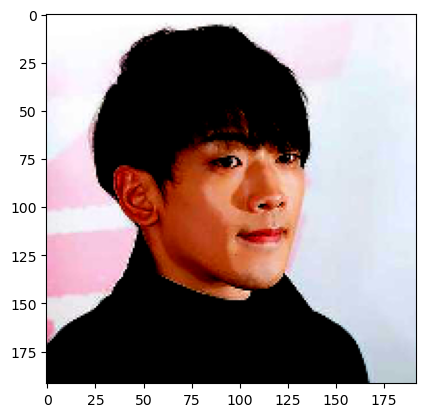

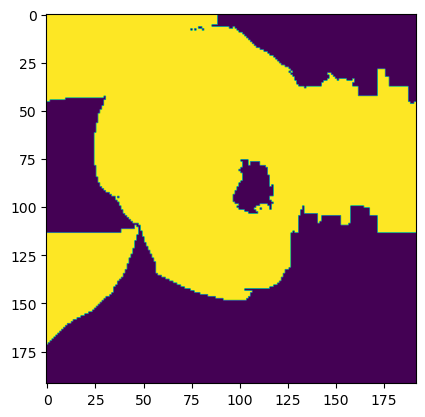

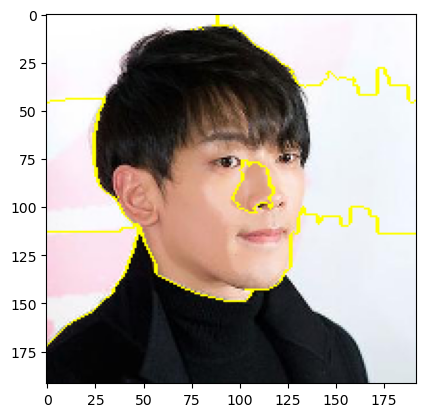

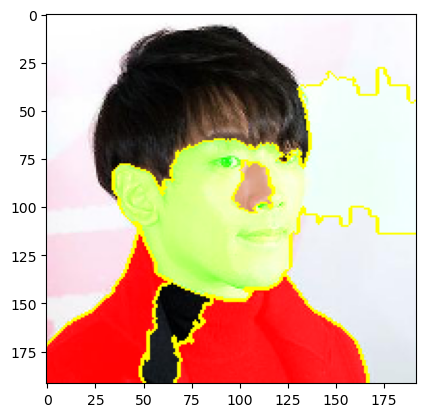

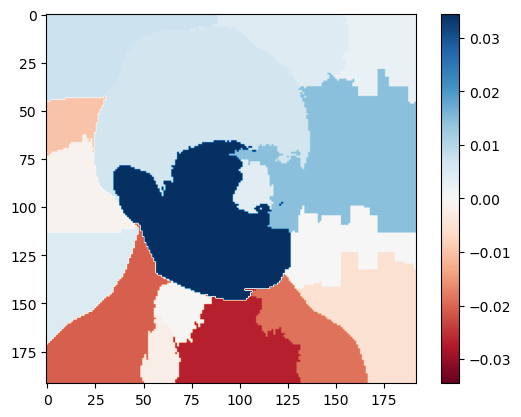

1/1 [==============================] - 0s 64ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 614ms/step
Segments


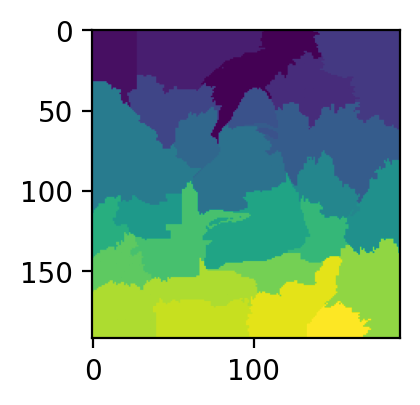

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


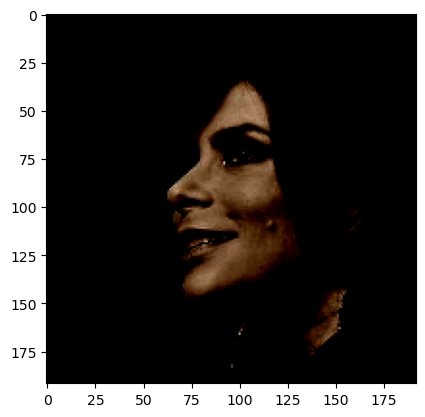

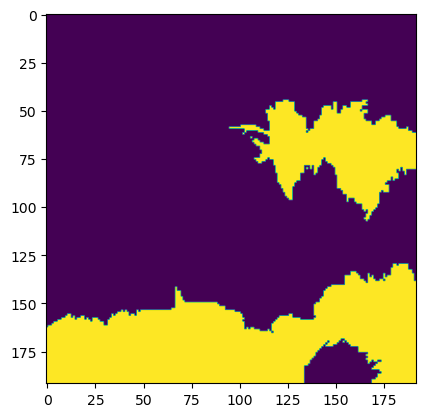

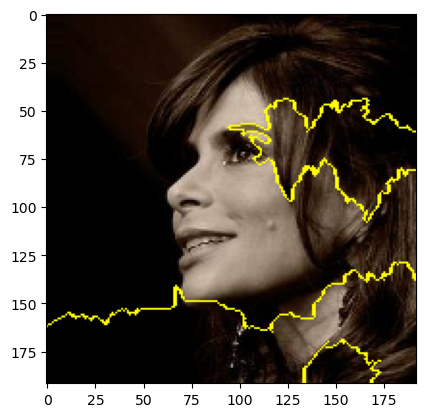

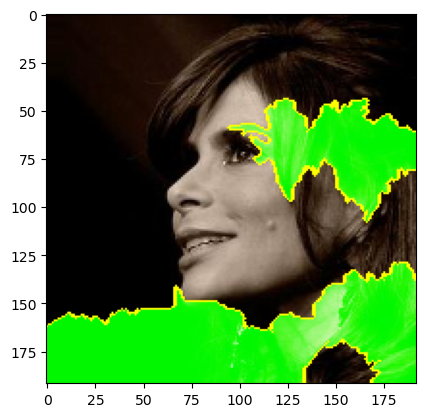

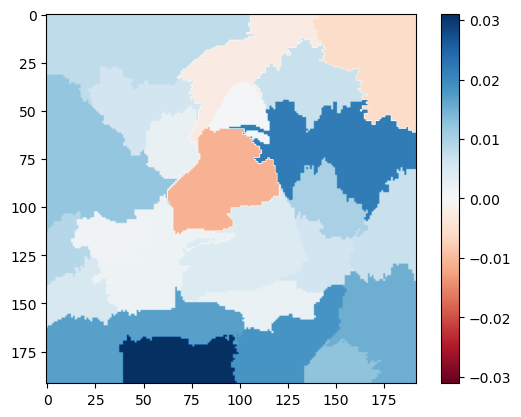

1/1 [==============================] - 0s 61ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 461ms/step
Segments


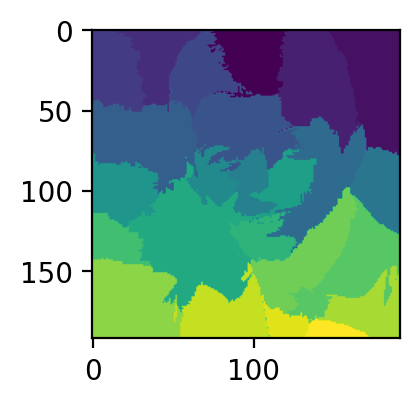

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


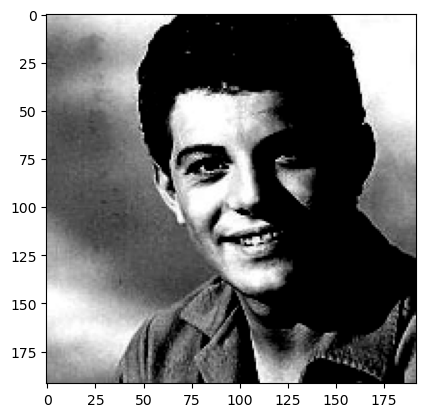

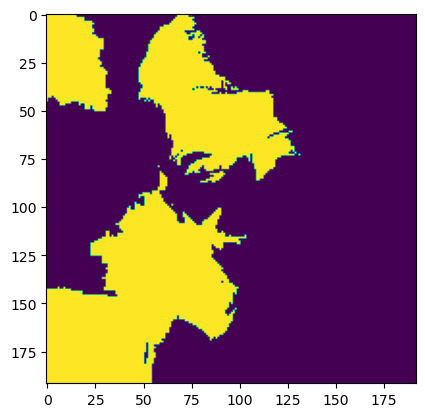

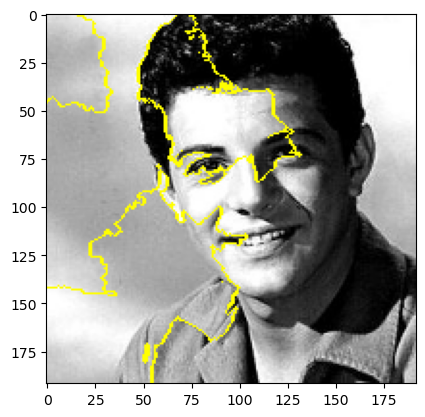

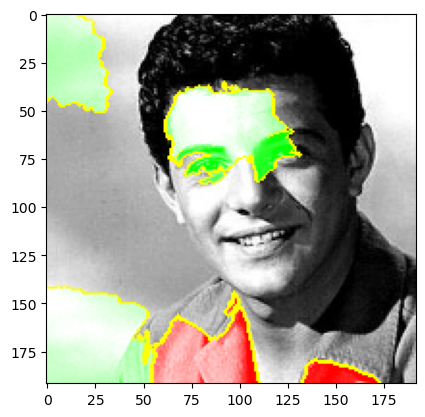

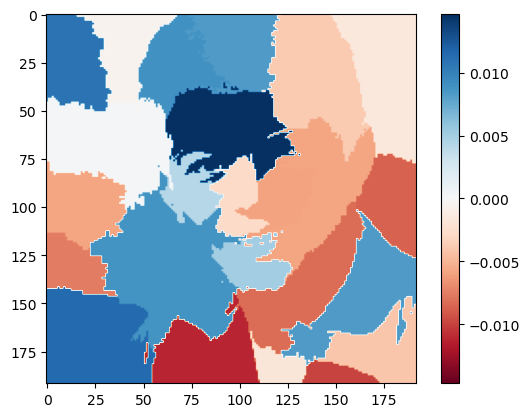

1/1 [==============================] - 0s 54ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 638ms/step
Segments


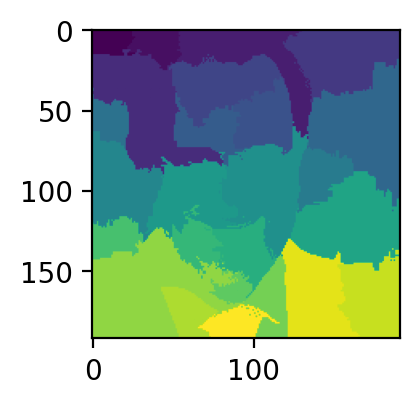

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


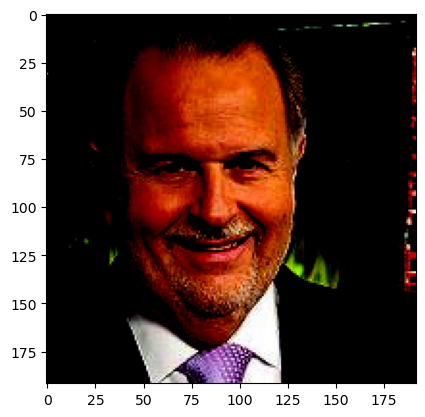

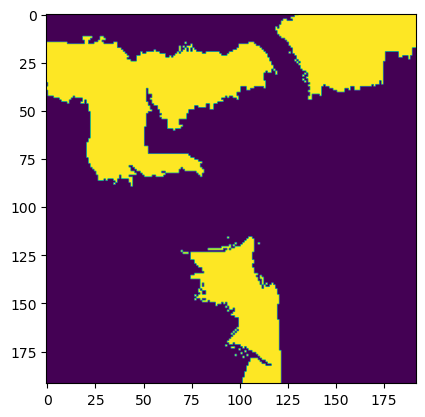

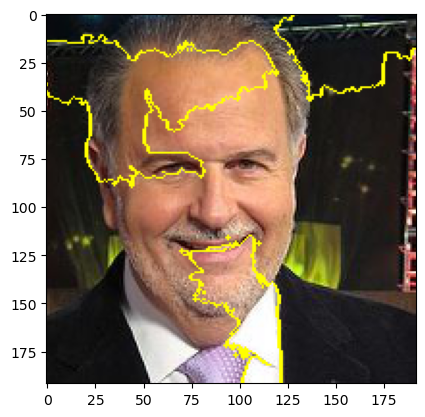

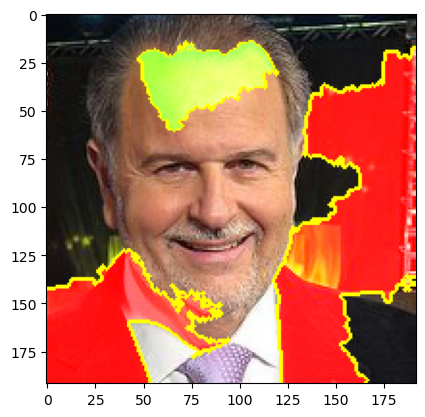

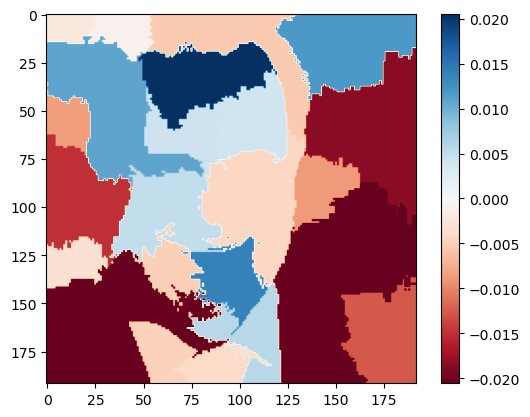

1/1 [==============================] - 0s 57ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 688ms/step
Segments


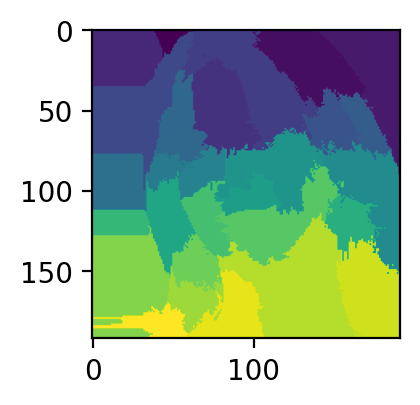

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


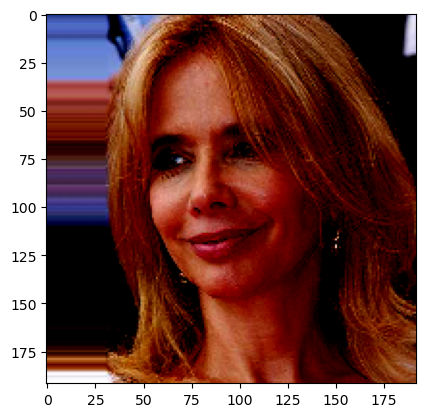

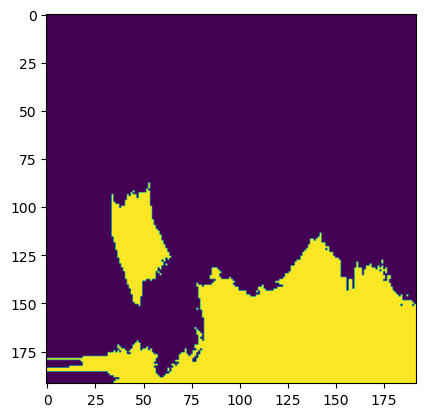

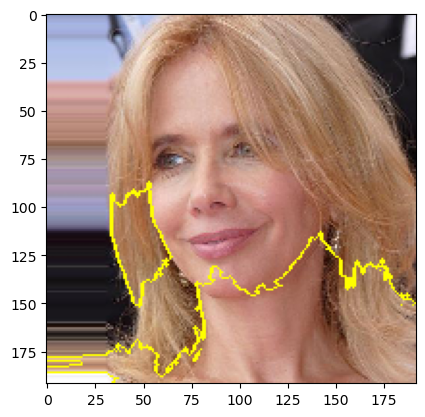

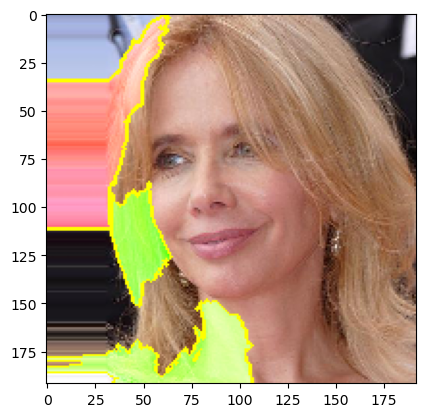

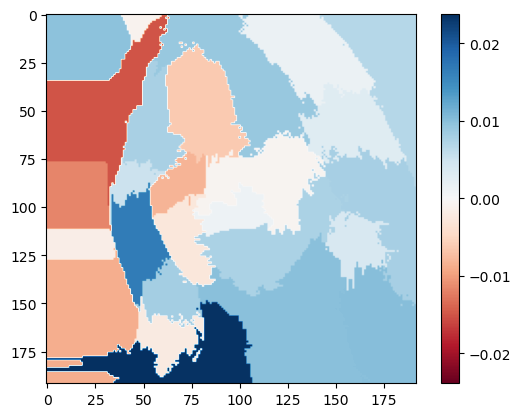

1/1 [==============================] - 0s 60ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 518ms/step
Segments


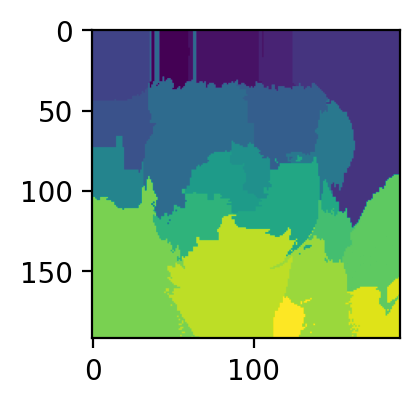

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


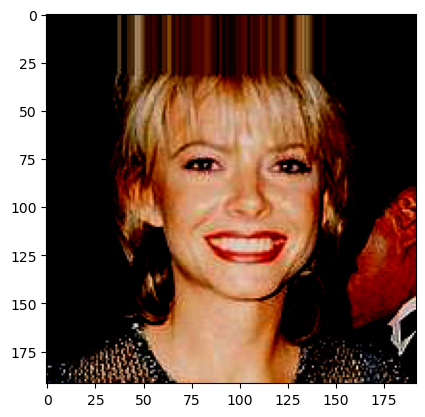

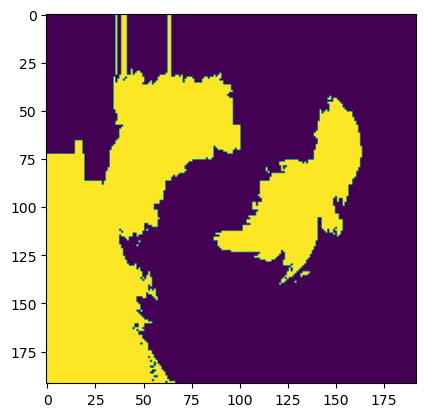

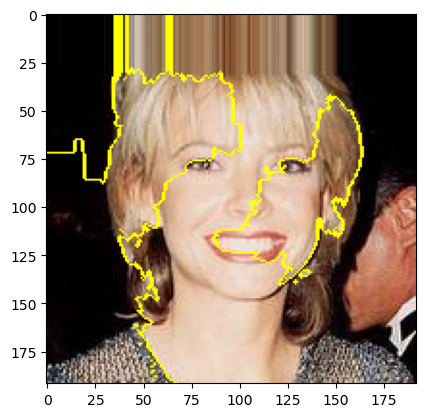

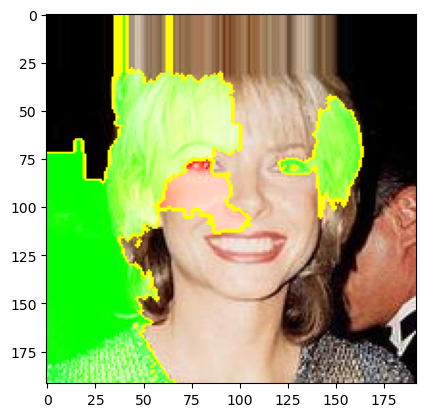

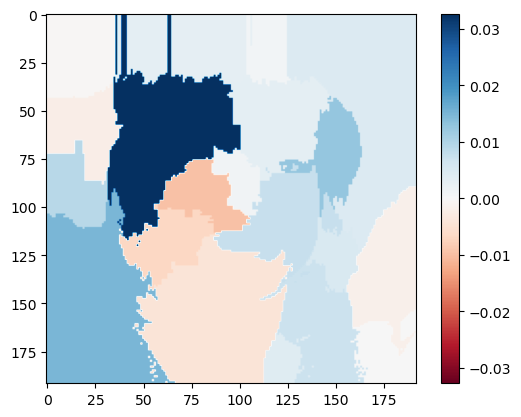

1/1 [==============================] - 0s 47ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 483ms/step
Segments


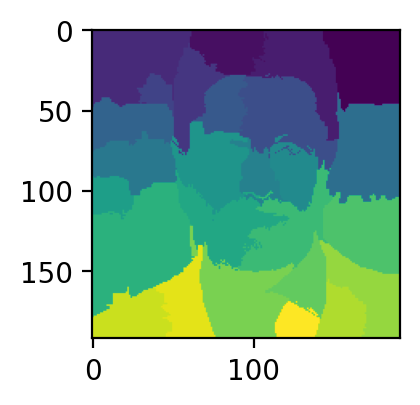

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


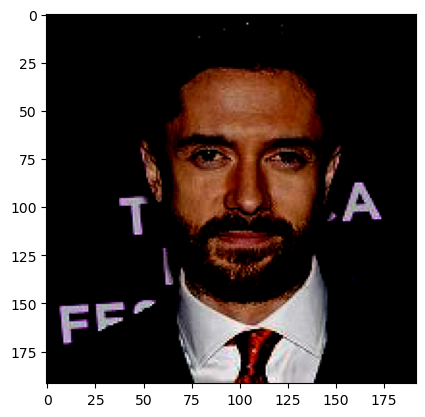

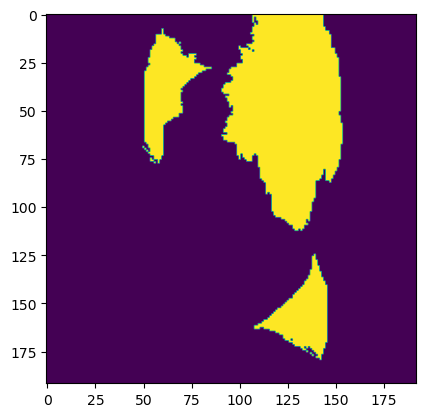

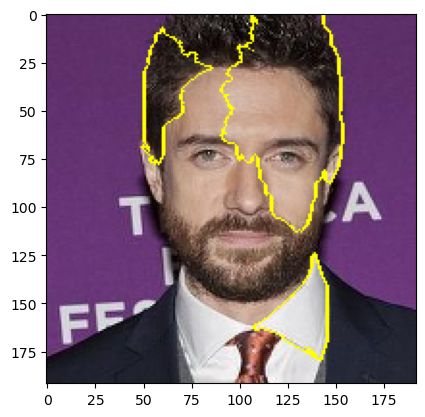

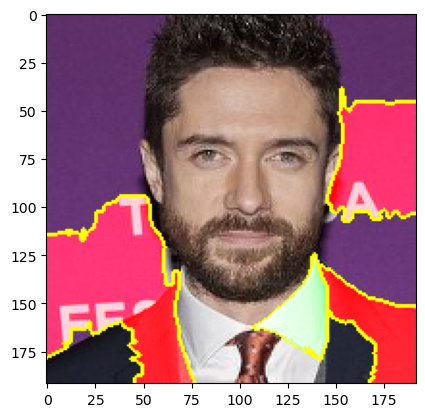

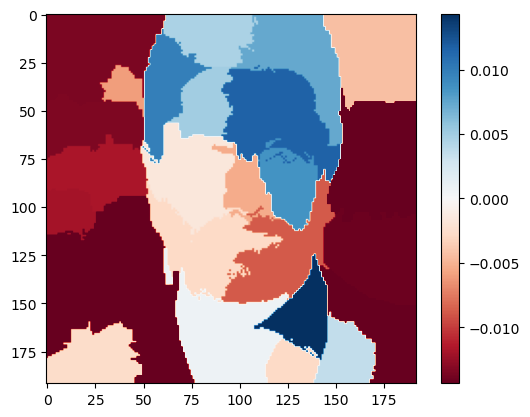

1/1 [==============================] - 0s 65ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 470ms/step
Segments


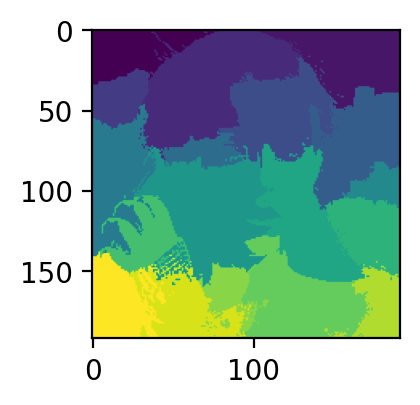

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


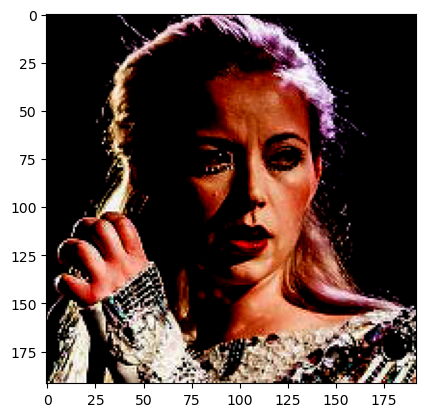

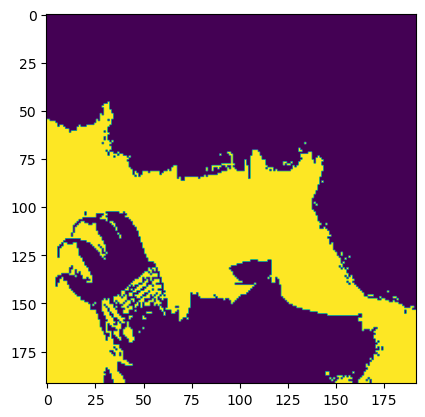

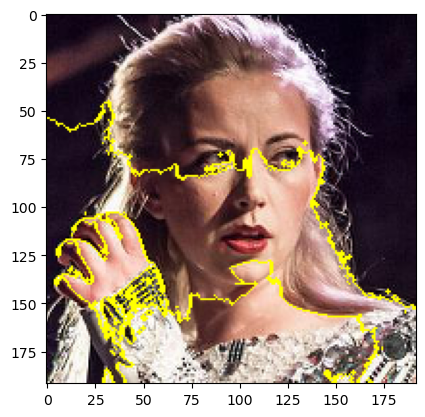

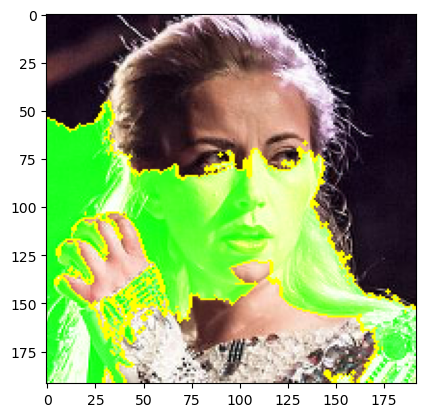

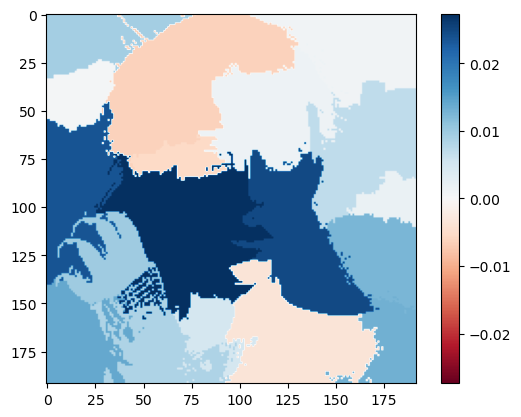

1/1 [==============================] - 0s 64ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 490ms/step
Segments


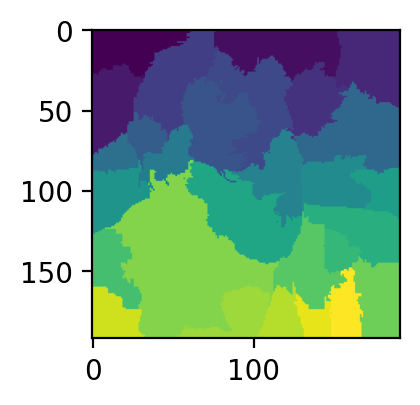

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


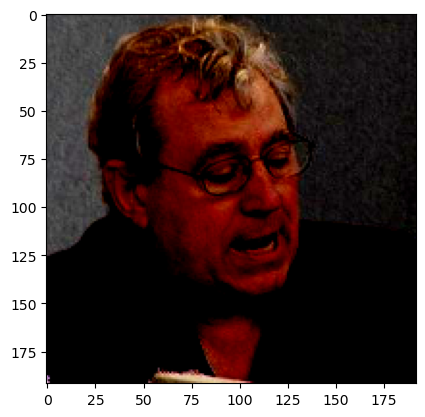

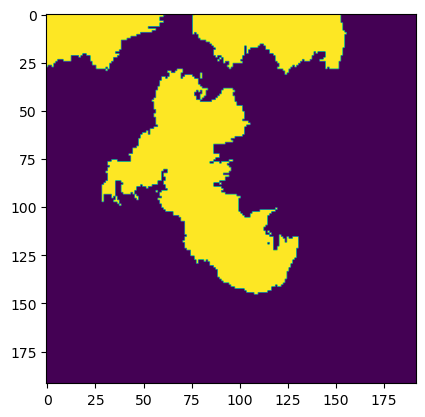

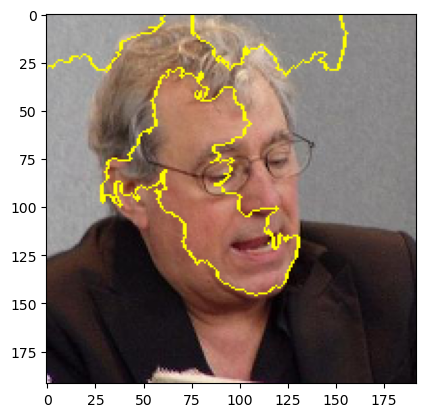

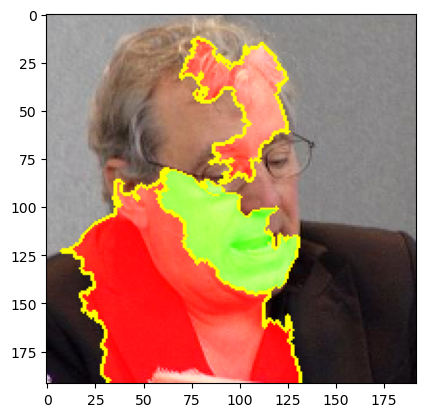

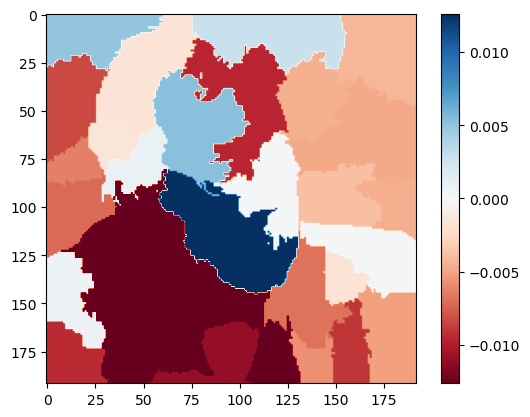

1/1 [==============================] - 0s 63ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 501ms/step
Segments


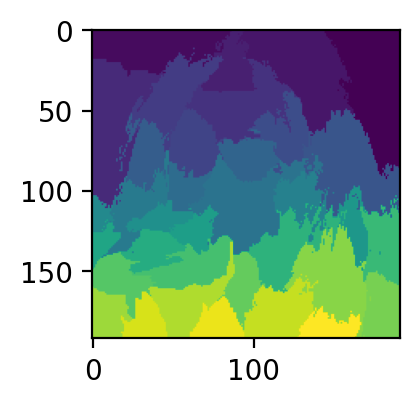

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


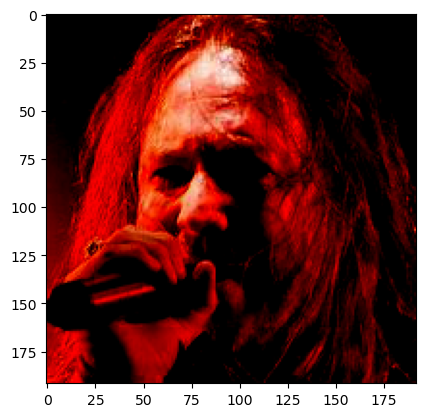

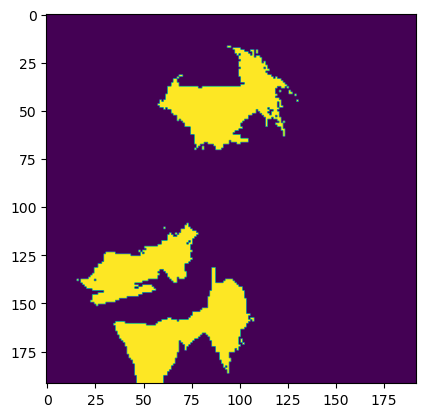

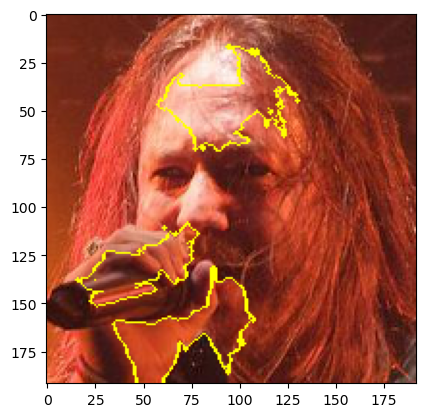

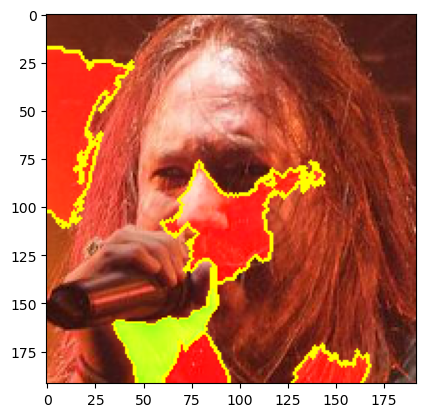

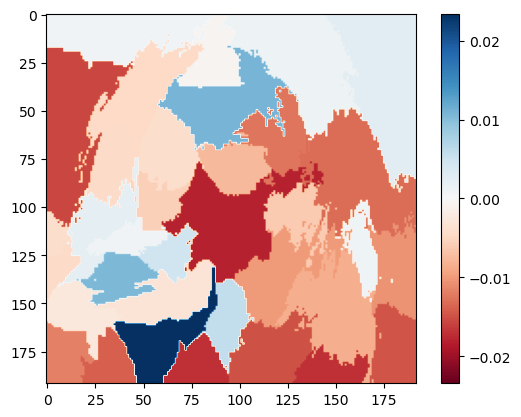

1/1 [==============================] - 0s 63ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 521ms/step
Segments


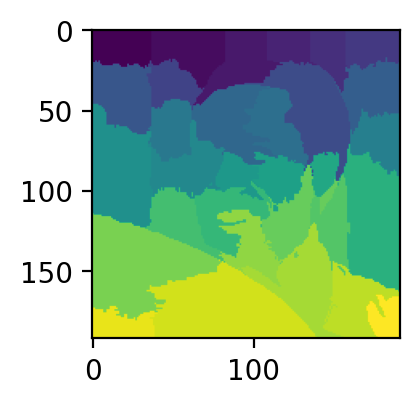

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


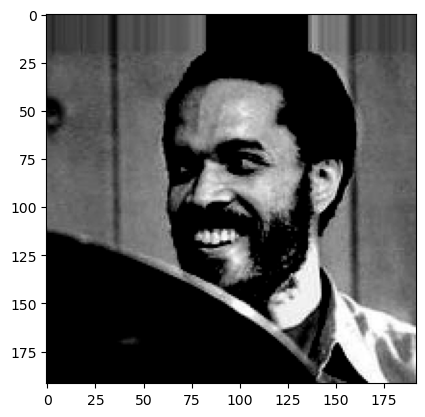

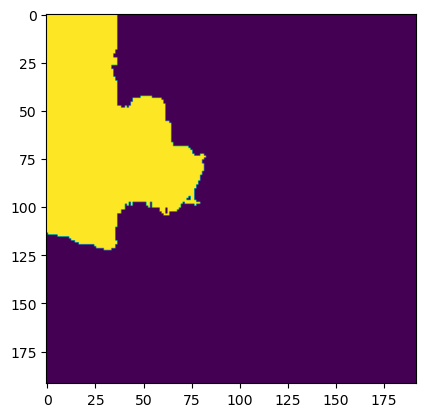

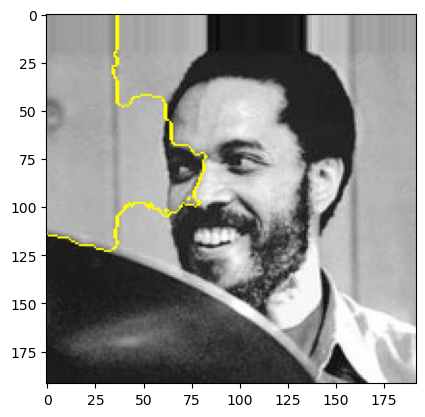

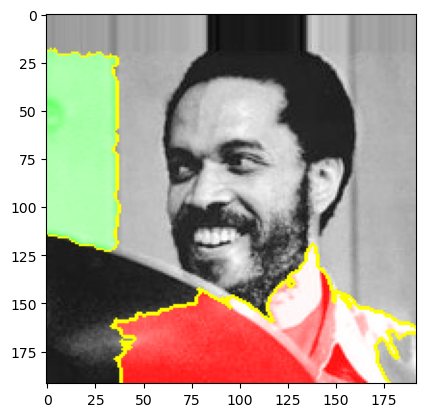

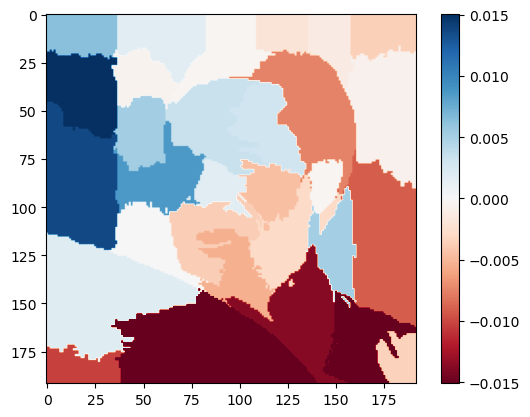

1/1 [==============================] - 0s 61ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 678ms/step
Segments


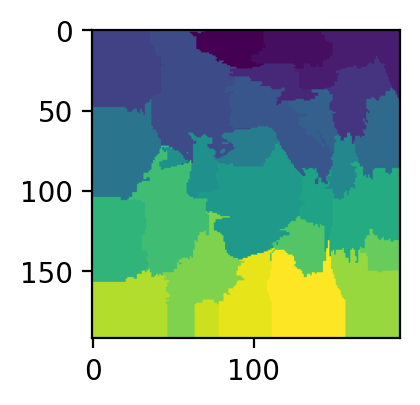

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


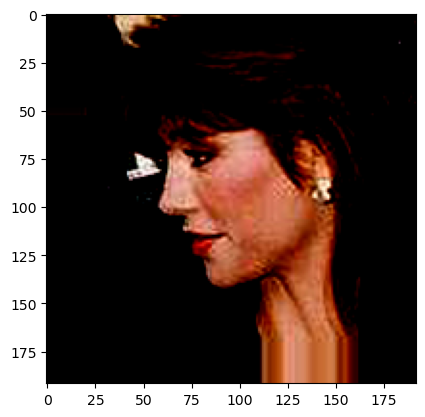

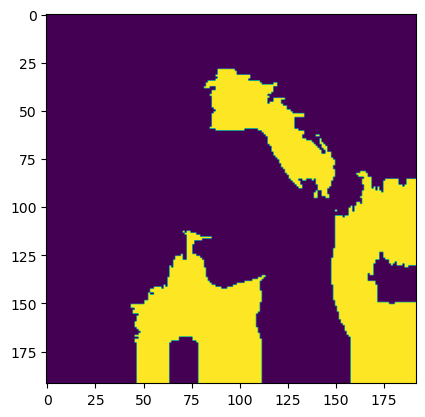

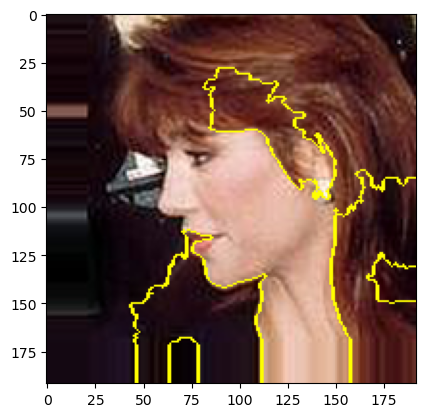

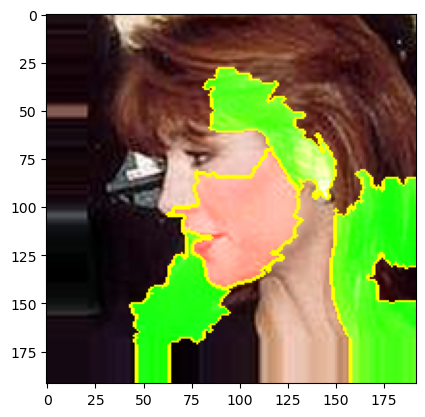

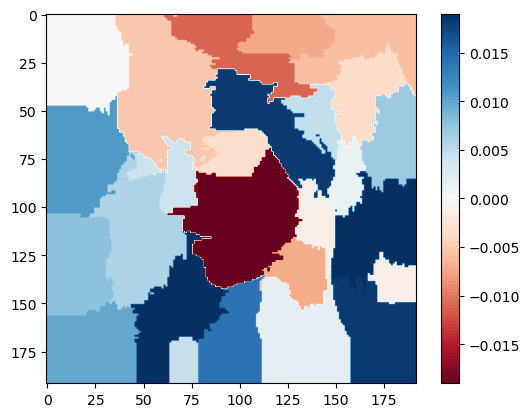

1/1 [==============================] - 0s 79ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 843ms/step
Segments


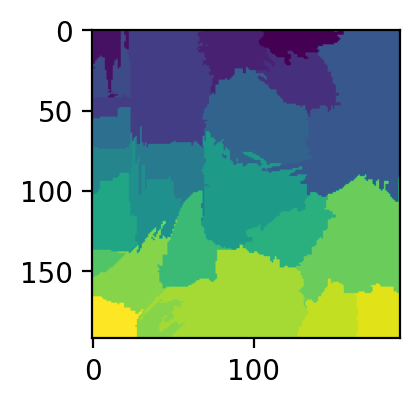

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


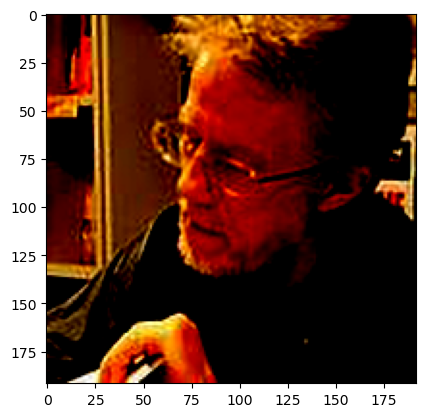

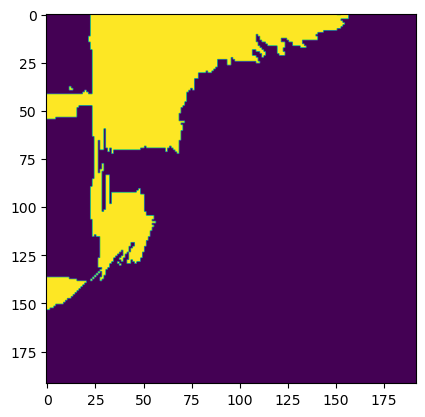

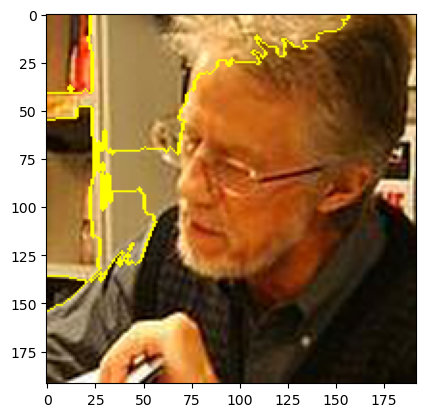

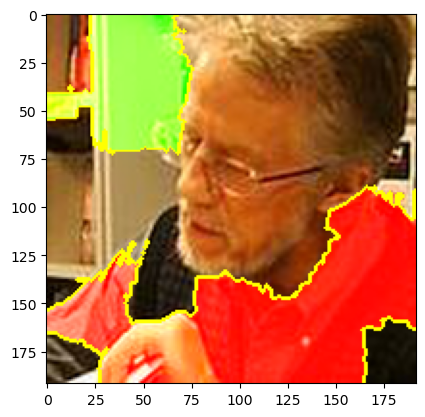

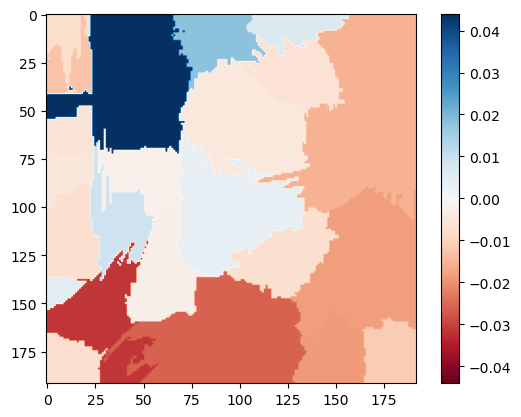

1/1 [==============================] - 0s 72ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
Segments


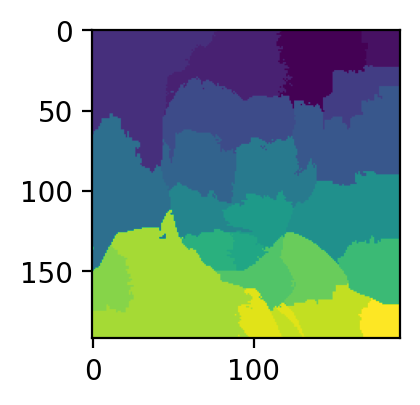

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


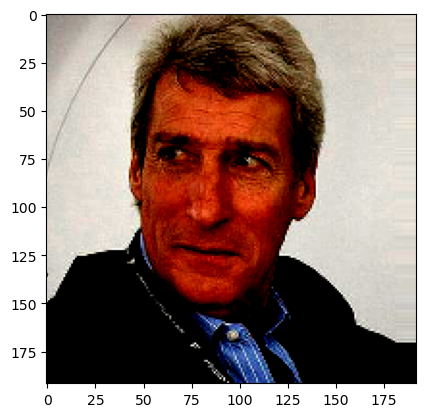

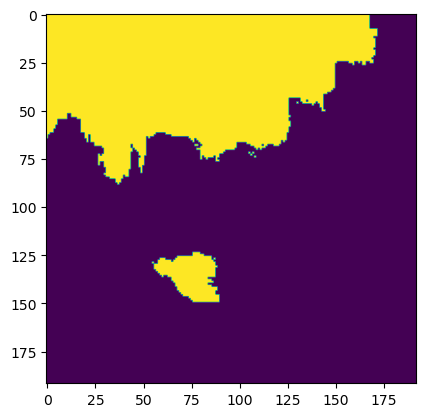

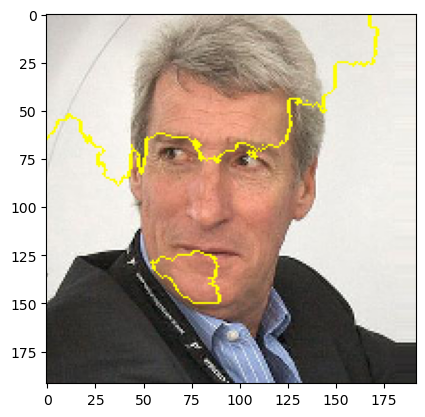

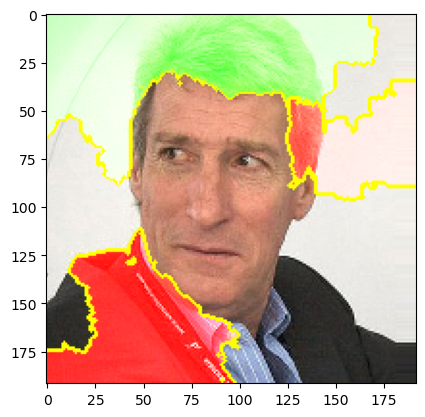

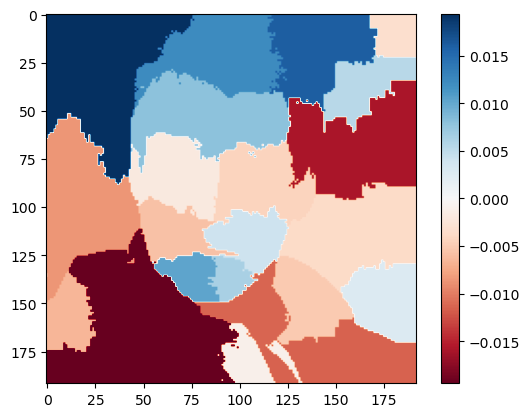

1/1 [==============================] - 0s 62ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
Segments


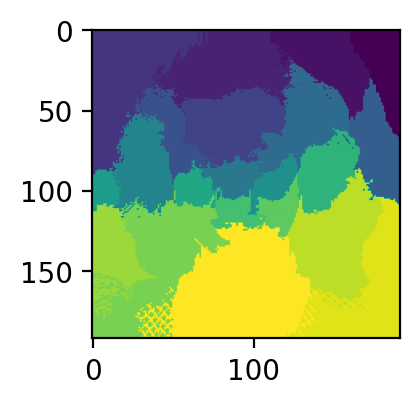

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


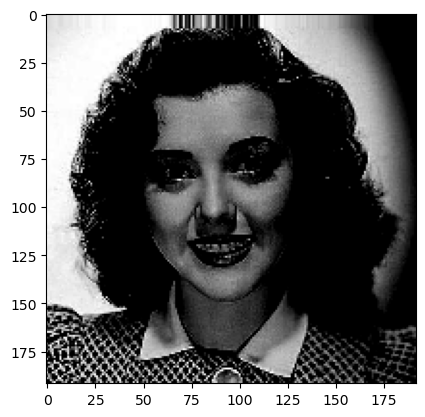

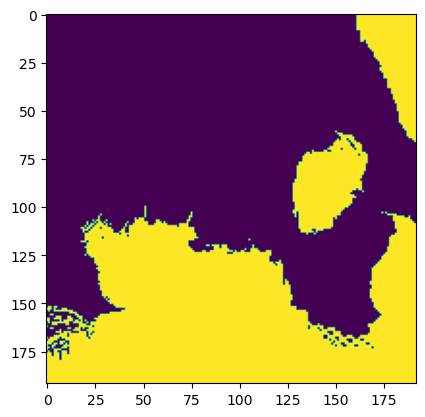

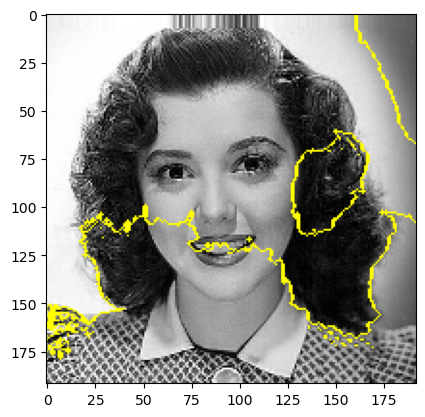

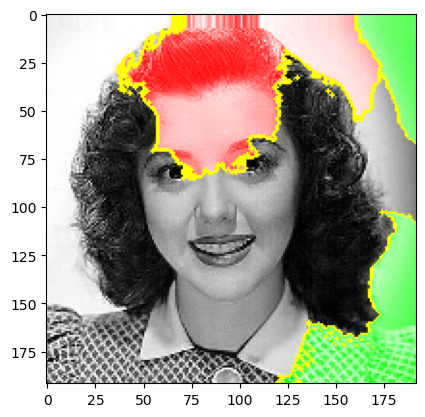

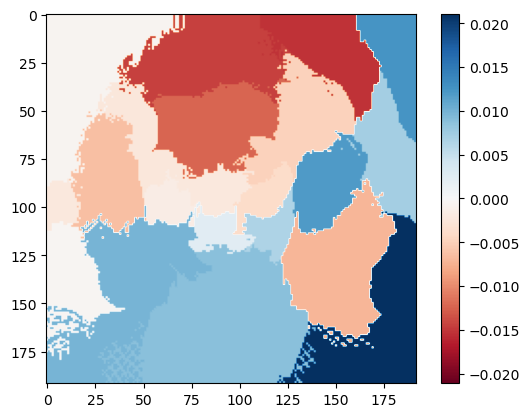

1/1 [==============================] - 0s 87ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 881ms/step
Segments


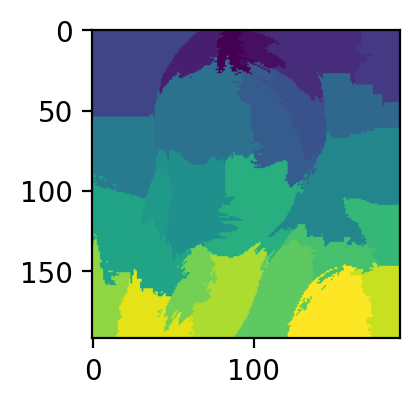

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


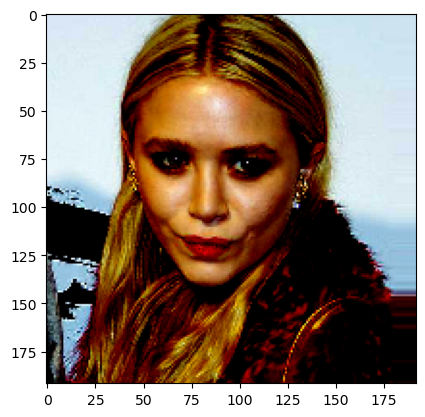

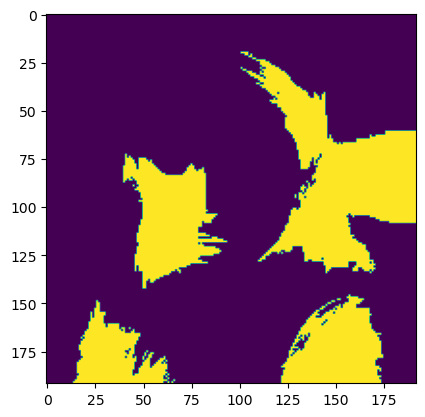

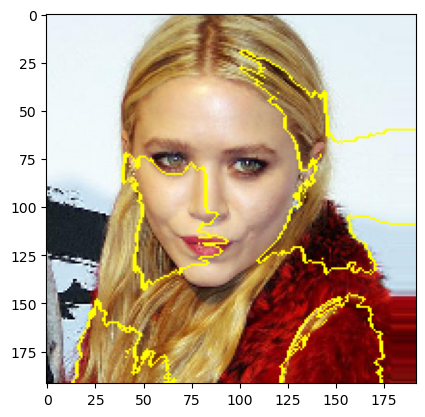

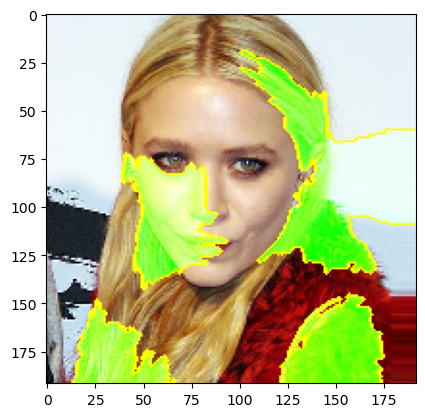

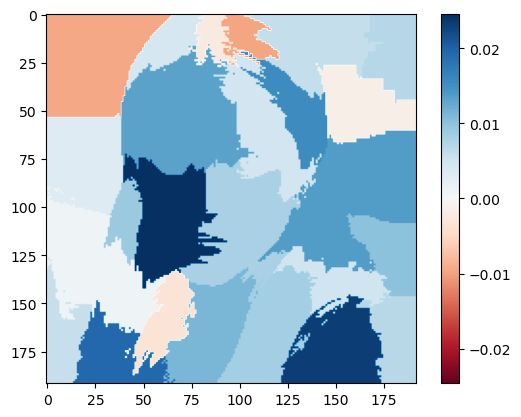

1/1 [==============================] - 0s 80ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
Segments


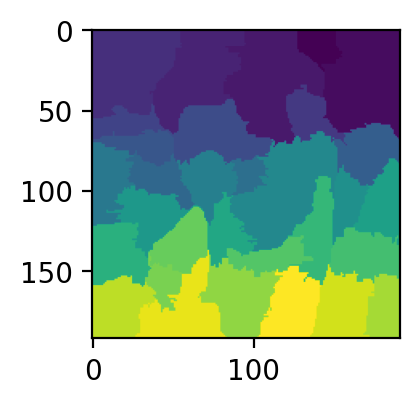

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


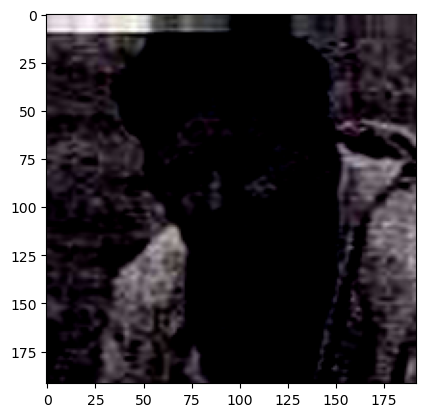

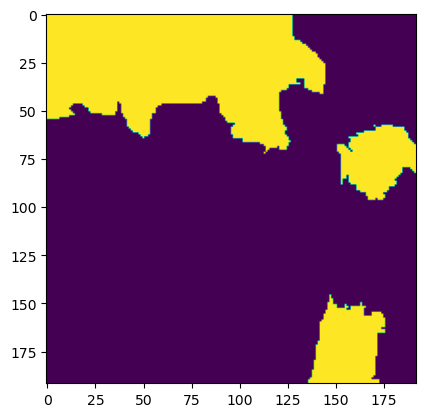

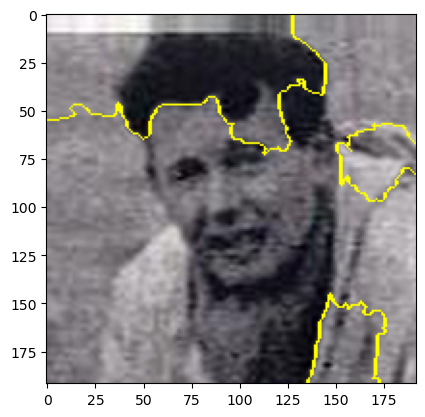

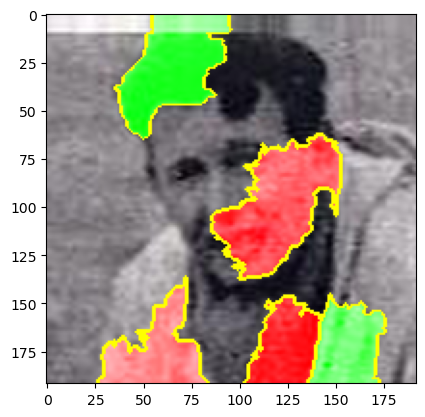

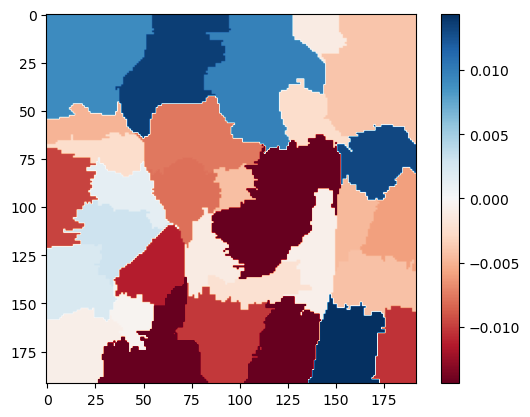

1/1 [==============================] - 0s 79ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 962ms/step
Segments


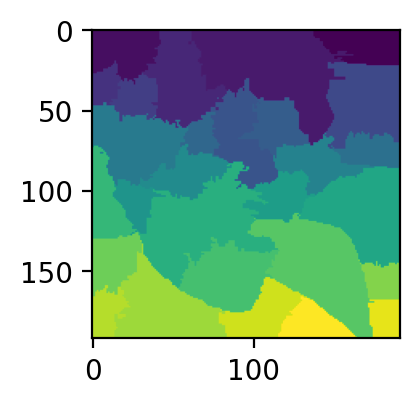

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


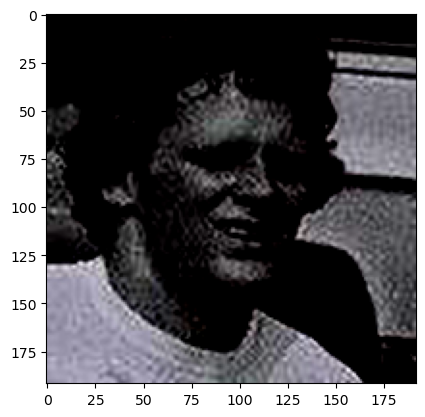

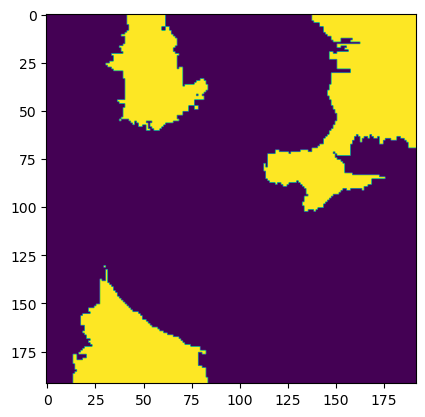

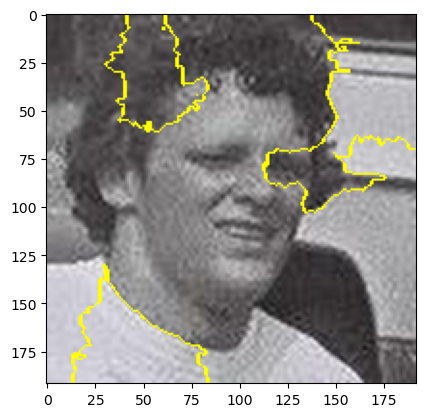

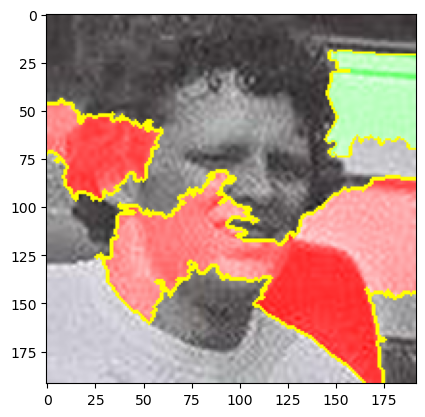

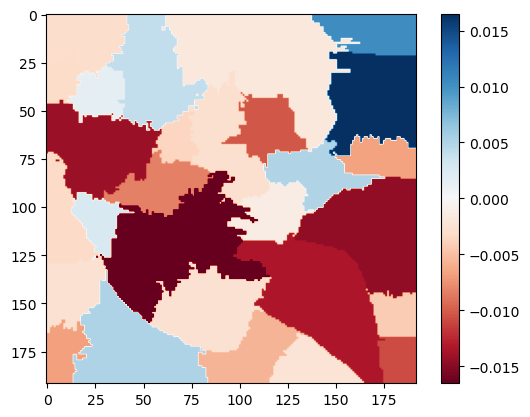

In [159]:
# Apply LIME to each image with the updated function
for filename, img in images.items():
    explain_with_lime(img, filename, gender_model)

<br></br>
<h3>Let's run Lime on other images</h3>

In [466]:
image1 = './face_classification/datasets/wiki_crop/Male/24095_1961-07-01_1995.jpg'

In [469]:
def load_and_display_images(image):
    img = load_img(image)
#     images[filename] = img
    plt.figure(figsize=(5, 5))
    plt.imshow(img)
    plt.title('Image')
    plt.axis('off')
    plt.show()

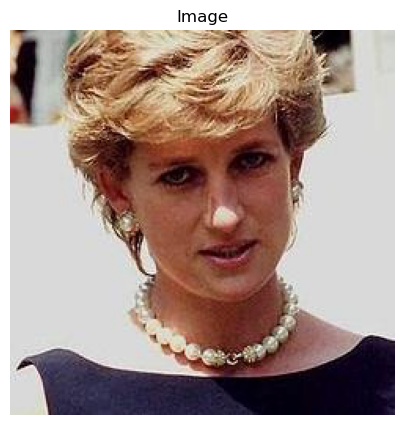

In [470]:
load_and_display_images(image_1)

In [475]:
def predict_and_display(model, image):
    img = load_img(image)
    preprocessed_img = cv2.resize(np.array(img), (48, 48))
    preprocessed_img = preprocess_image_for_model(preprocessed_img)
    predictions = model.predict(preprocessed_img)
    predicted_class = np.argmax(predictions, axis=1)[0]
    print("Predicted_calss", predicted_class)
    confidence = predictions[0][predicted_class]
    predicted_label = gender_labels[predicted_class]
    plt.figure(figsize=(5, 5))
    plt.imshow(img)
    plt.title(f'Predicted: {predicted_label} ({confidence:.2f})')
    plt.axis('off')
    plt.show()

1/1 [==============================] - 0s 147ms/step
Predicted_calss 1


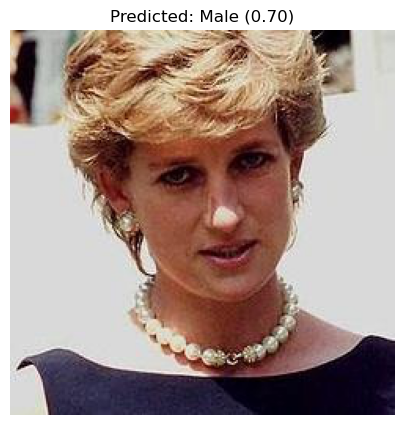

In [476]:
# Load images from the folder
predict_and_display(gender_model, image1)

In [477]:
def explain_with_lime(img, model, num_samples=500):
    explainer = lime_image.LimeImageExplainer()

    # Resize for model prediction
    model_size = (48, 48)
    model_img = cv2.resize(np.array(img), model_size, interpolation=cv2.INTER_AREA)
    preprocessed_model_img = preprocess_image_for_model(model_img)

    # Get the model's prediction first
    prediction = model.predict(preprocessed_model_img)
    predicted_class = np.argmax(prediction, axis=1)[0]

    # Resize for LIME visualization
    lime_size = (192, 192)
    lime_img = cv2.resize(np.array(img), lime_size, interpolation=cv2.INTER_LANCZOS4)
    preprocessed_lime_img = preprocess_image_for_model(lime_img)

    # Now use LIME to explain this prediction on the upscaled image
    explanation = explainer.explain_instance(preprocessed_lime_img[0].astype('double'), 
                                             model.predict, 
                                             top_labels=2, 
                                             hide_color=0, 
                                             num_samples=num_samples)

    print("Segments")
    plt.figure(figsize=(2, 2), dpi=200)
    plt.imshow(explanation.segments)
    plt.show()

    # Use the predicted class for the explanation
    label = predicted_class
    print("Label used for explanation:", label)
    
    a = explanation.get_image_and_mask(label=label)
    print(a[0].shape, a[1].shape)
    plt.imshow(a[0])
    plt.show()
    plt.imshow(a[1])
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only=True, num_features=5, hide_rest=False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()
    
    temp, mask = explanation.get_image_and_mask(label, positive_only=False, num_features=5, hide_rest=False)
    plt.imshow(mark_boundaries(temp/2+0.5, mask))
    plt.show()
    
    ind = label
    dict_heatmap = dict(explanation.local_exp[ind])
    heatmap = np.vectorize(dict_heatmap.get)(explanation.segments)

    # Plotting the visualization
    plt.imshow(heatmap, cmap="RdBu", vmin=-heatmap.max(), vmax=heatmap.max())
    plt.colorbar()
    plt.show()

1/1 [==============================] - 0s 55ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
Segments


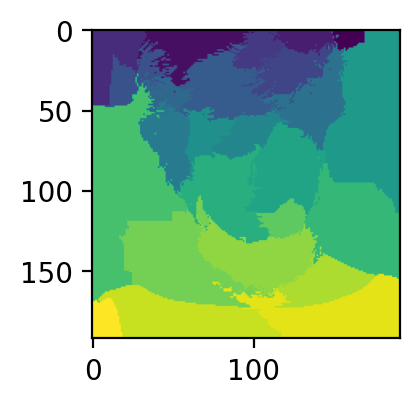

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


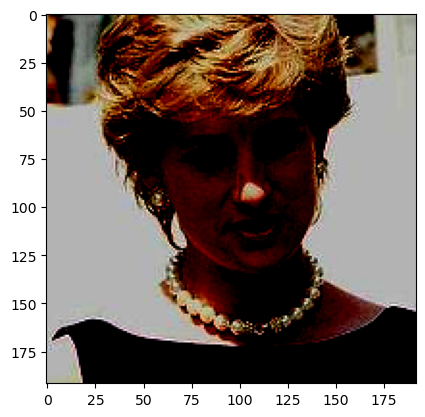

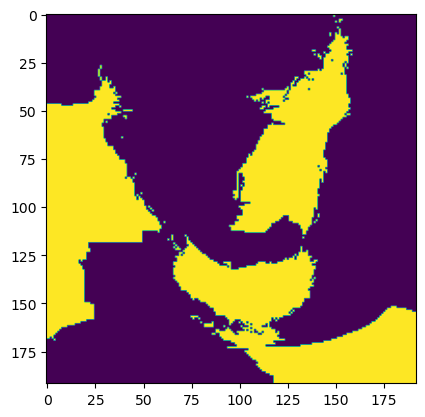

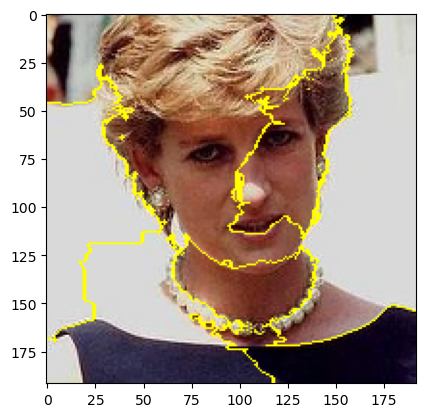

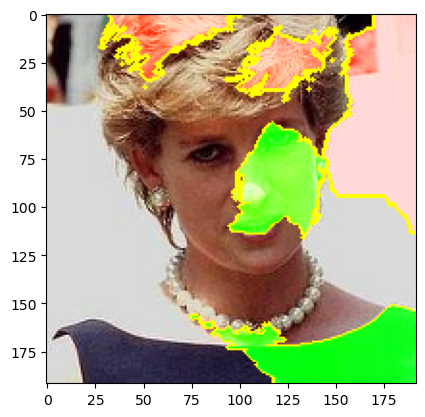

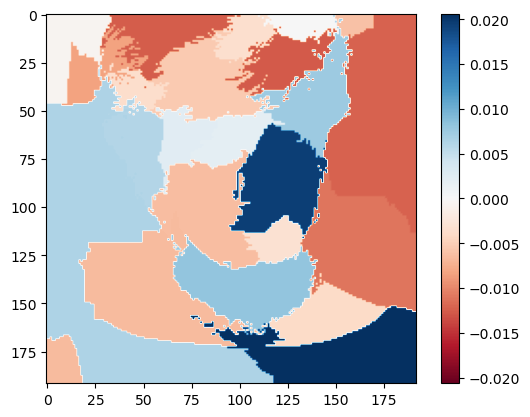

In [478]:
# Apply LIME to each image with the updated function
img = load_img(image_1)
explain_with_lime(img, gender_model)

In [216]:
image_2 = './face_classification/datasets/wiki_crop/08/1850808_1980-09-06_2013.jpg'

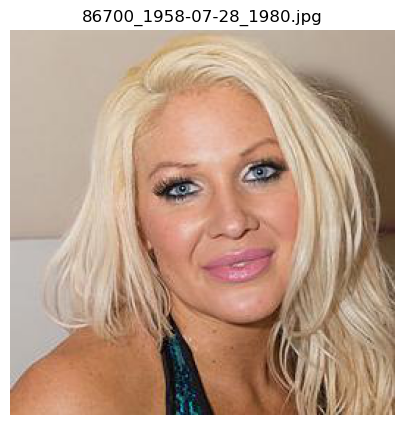

In [217]:
load_and_display_images(image_2)

1/1 [==============================] - 0s 45ms/step
Predicted_calss 0


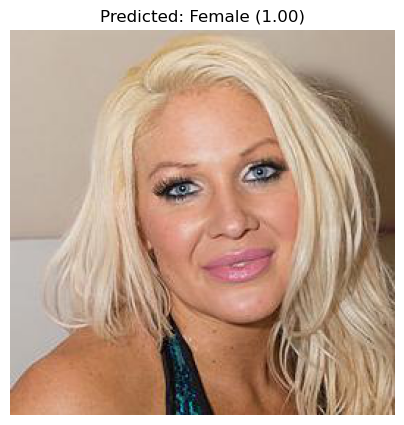

In [218]:
predict_and_display(gender_model, image_2)

1/1 [==============================] - 0s 45ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 904ms/step
Segments


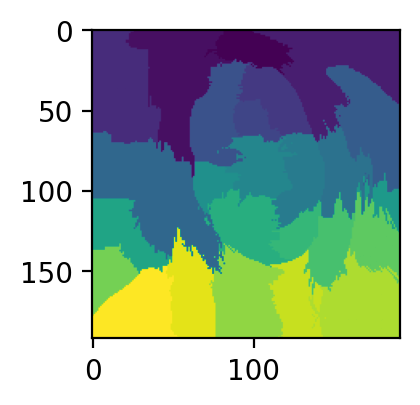

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


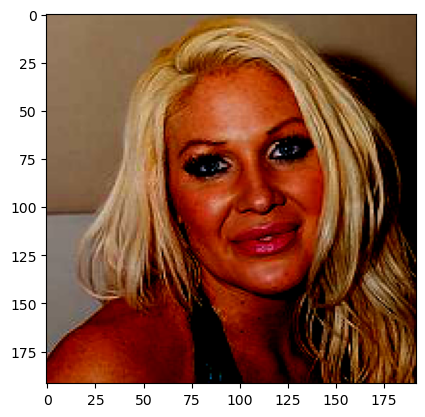

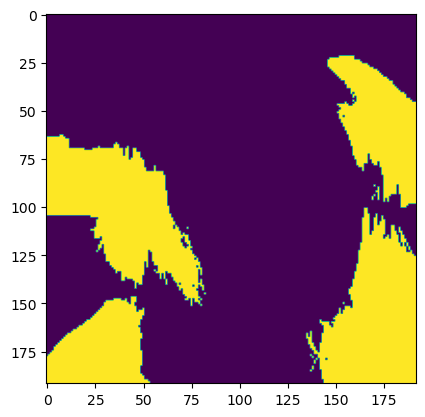

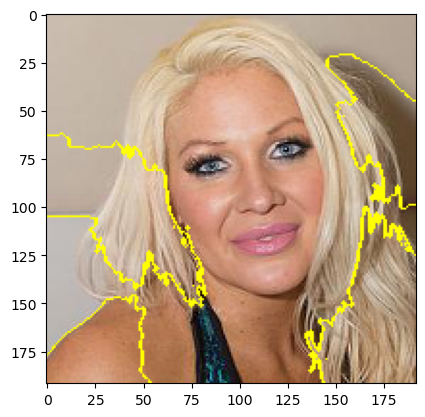

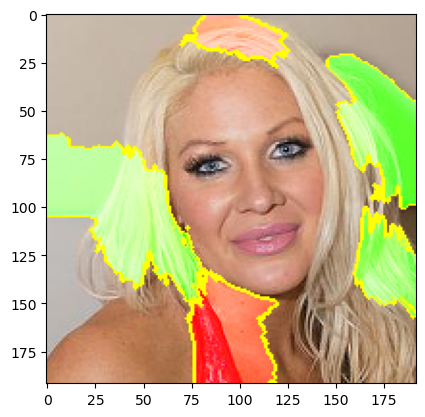

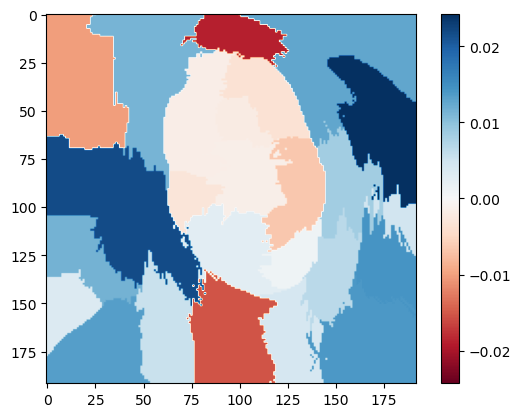

In [219]:
img2 = load_img(image_2)
explain_with_lime(img2, gender_model)

In [220]:
image_3 = './face_classification/datasets/wiki_crop/08/5539908_1970-08-12_2010.jpg'

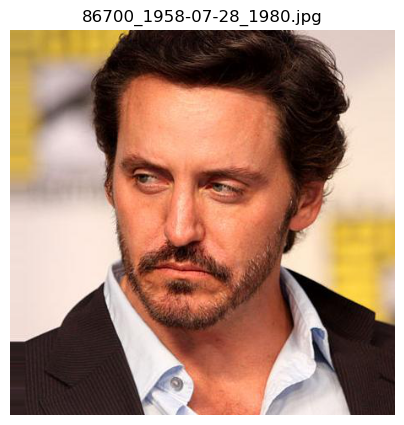

In [221]:
load_and_display_images(image_3)

1/1 [==============================] - 0s 68ms/step
Predicted_calss 1


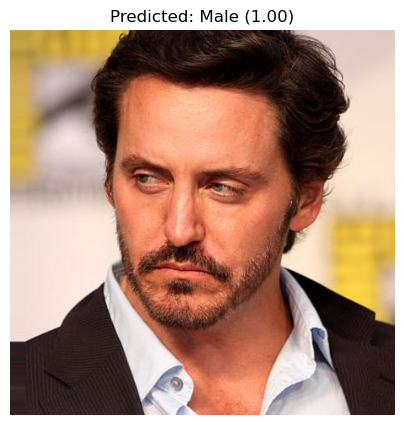

In [222]:
predict_and_display(gender_model, image_3)

1/1 [==============================] - 0s 39ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 988ms/step
Segments


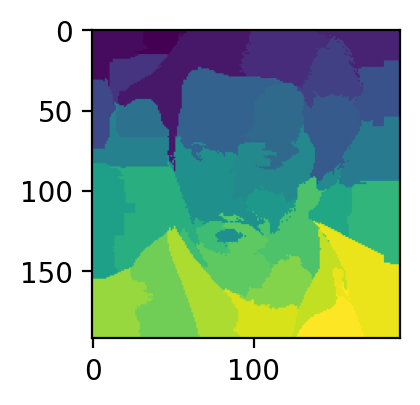

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


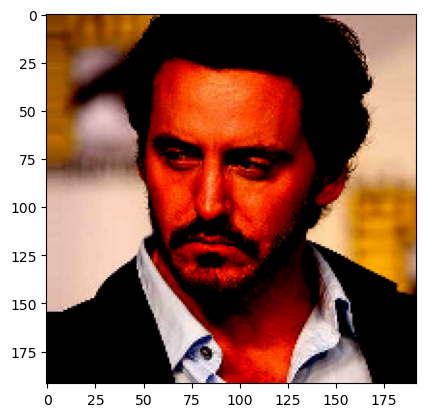

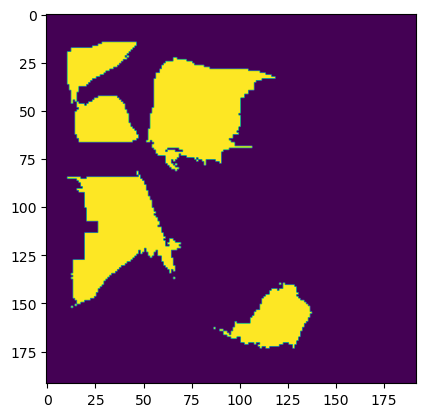

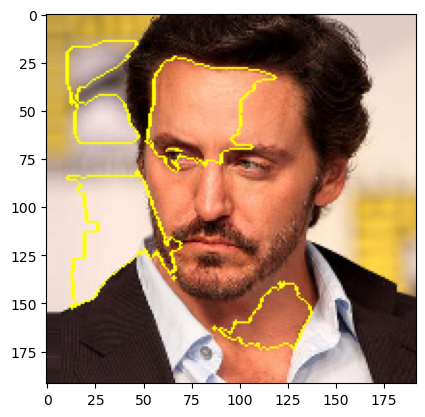

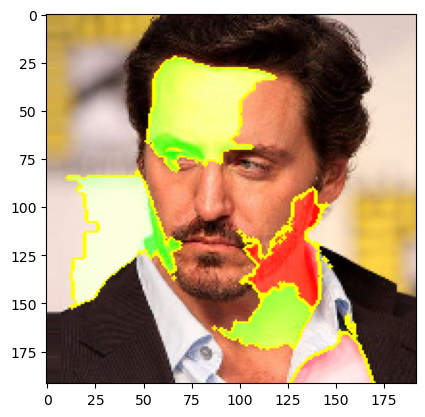

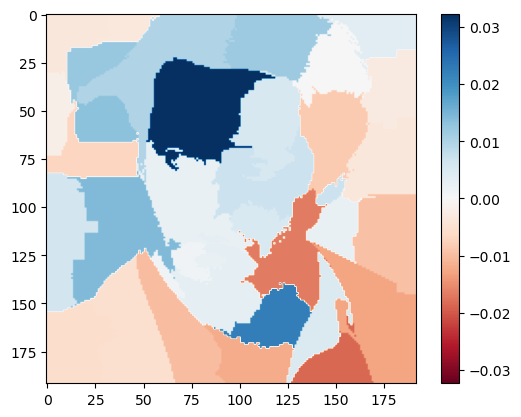

In [224]:
img3 = load_img(image_3)
explain_with_lime(img3, gender_model)

In [228]:
image_4 = './face_classification/datasets/wiki_crop/08/16789908_1985-08-09_2014.jpg'

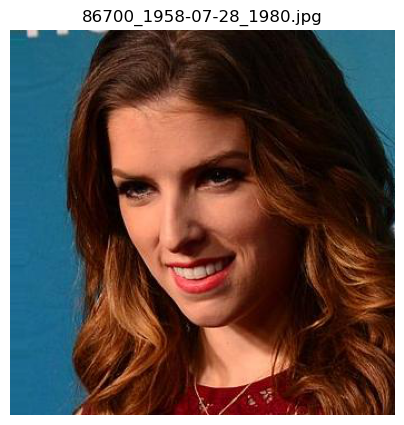

In [229]:
load_and_display_images(image_4)

1/1 [==============================] - 0s 54ms/step
Predicted_calss 0


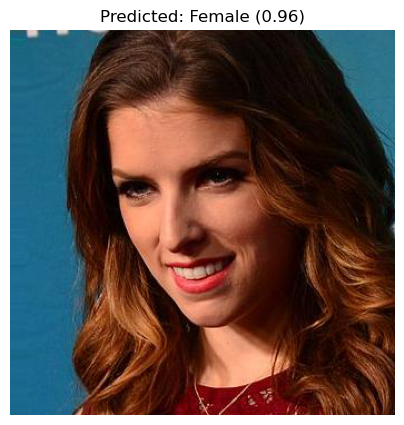

In [230]:
predict_and_display(gender_model, image_4)

1/1 [==============================] - 0s 62ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 954ms/step
Segments


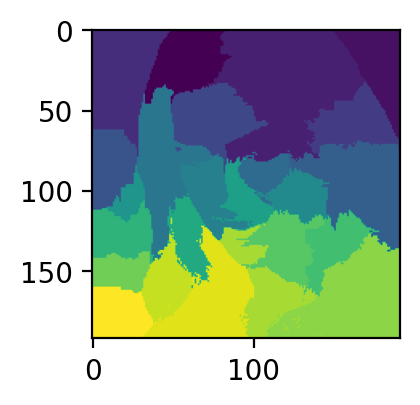

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 0
(192, 192, 3) (192, 192)


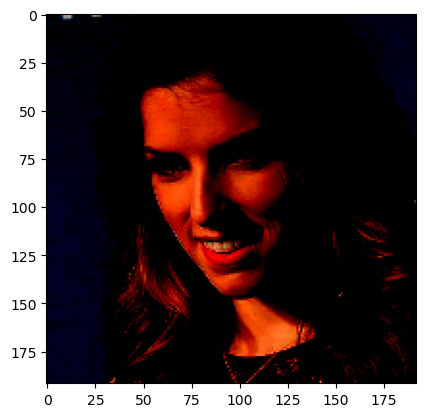

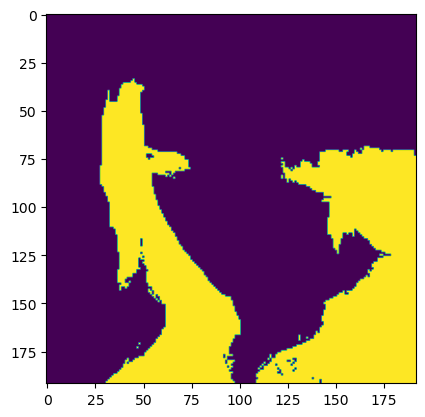

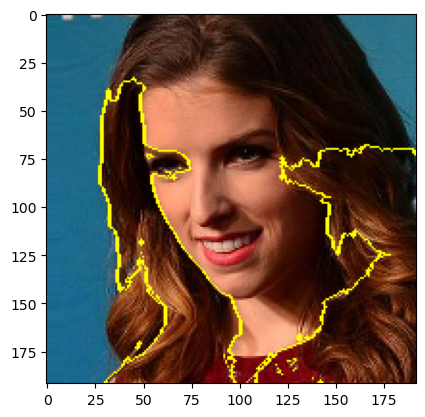

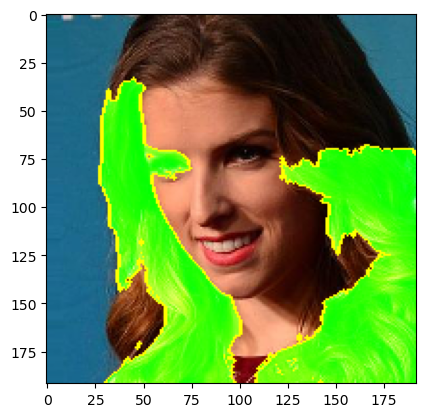

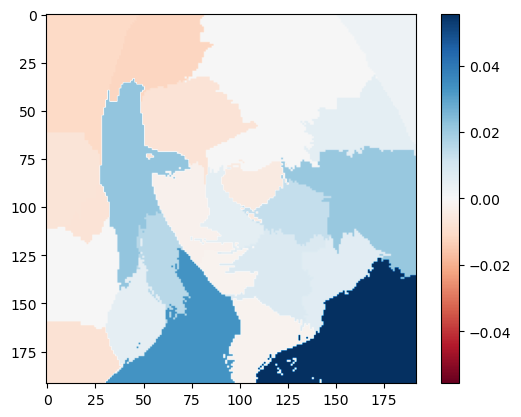

In [231]:
img4 = load_img(image_4)
explain_with_lime(img4, gender_model)

In [232]:
image_5 = './face_classification/datasets/wiki_crop/11/923811_1981-06-21_2010.jpg'

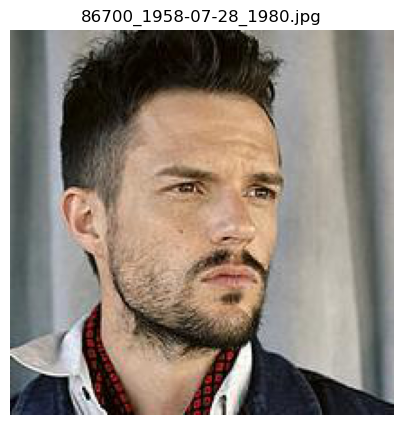

In [233]:
load_and_display_images(image_5)

1/1 [==============================] - 0s 38ms/step
Predicted_calss 1


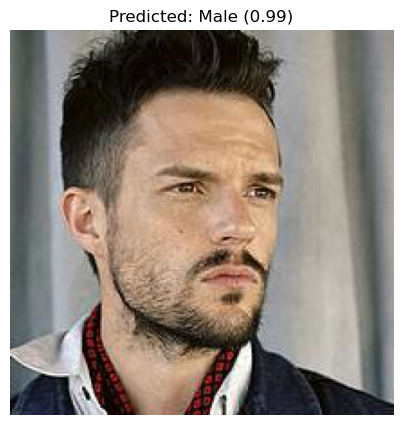

In [234]:
predict_and_display(gender_model, image_5)

1/1 [==============================] - 0s 64ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
Segments


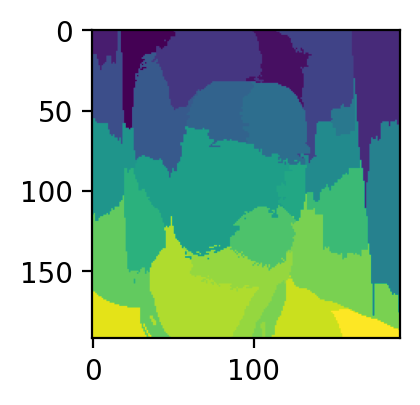

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


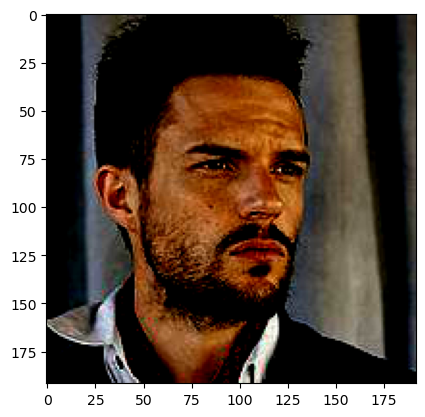

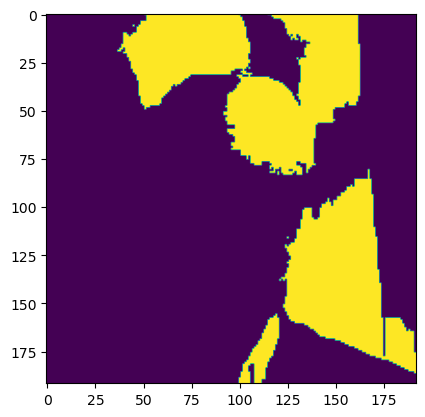

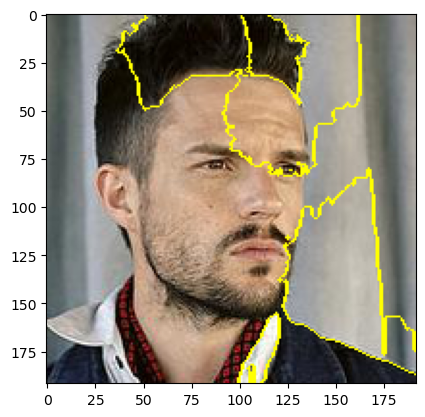

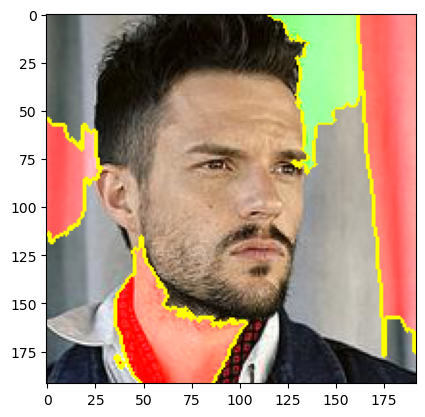

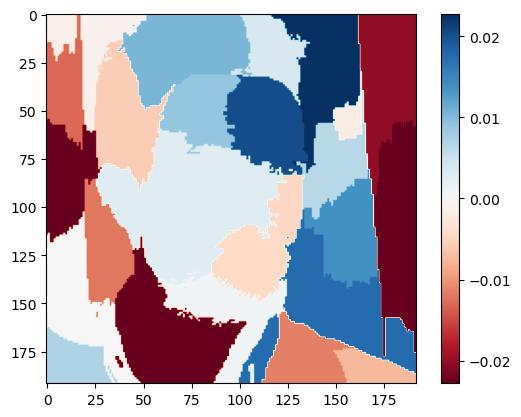

In [235]:
img5 = load_img(image_5)
explain_with_lime(img5, gender_model)

In [237]:
image_6 = './face_classification/datasets/wiki_crop/11/1480511_1978-06-10_2015.jpg'

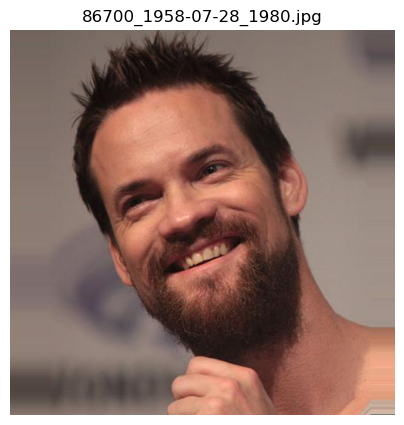

In [238]:
load_and_display_images(image_6)

1/1 [==============================] - 0s 55ms/step
Predicted_calss 1


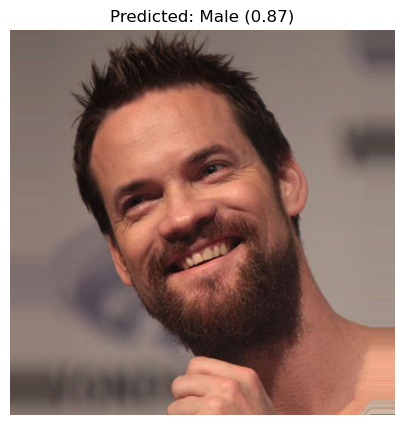

In [239]:
predict_and_display(gender_model, image_6)

1/1 [==============================] - 0s 46ms/step


  0%|          | 0/500 [00:00<?, ?it/s]

1/1 [==============================] - 1s 1s/step
Segments


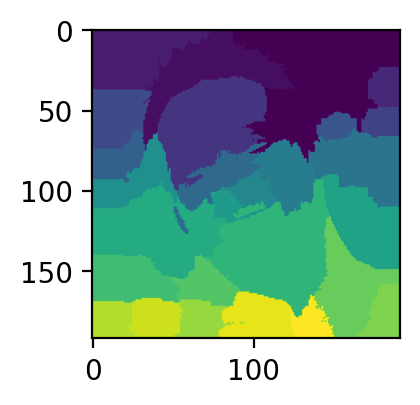

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Label used for explanation: 1
(192, 192, 3) (192, 192)


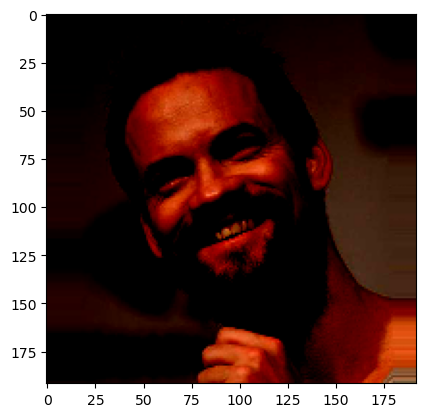

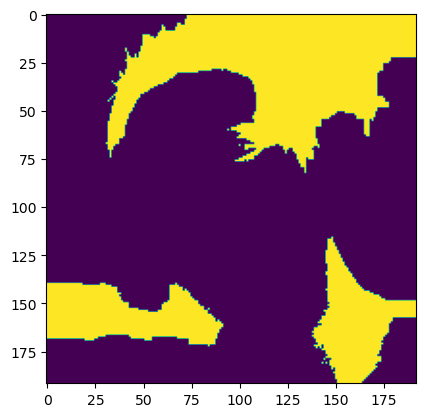

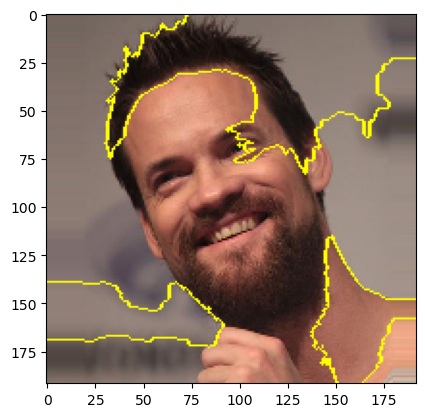

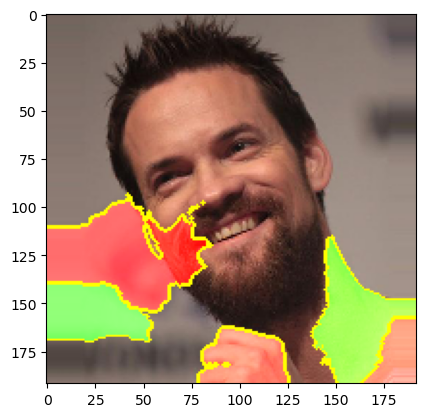

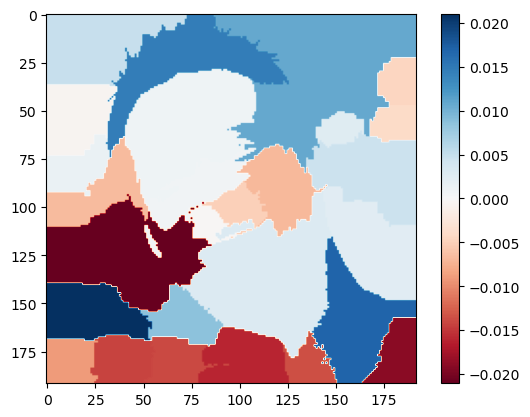

In [240]:
img6 = load_img(image_6)
explain_with_lime(img6, gender_model)

In [498]:
image_test = load_img(image_4)
img_test = image_test.resize((48, 48))
x1 = preprocess_image_for_model(img_test)

In [499]:
type(x1)

numpy.ndarray

In [500]:
x1

array([[[[-0.77254903, -0.23137254, -0.09019607],
         [-0.70980394, -0.2235294 , -0.06666666],
         [ 0.23921573,  0.30196083,  0.38823533],
         ...,
         [-0.6313726 , -0.09803921,  0.082353  ],
         [-0.62352943, -0.09019607,  0.09019613],
         [-0.6392157 , -0.10588235,  0.07450986]],

        [[-0.84313726, -0.17647058, -0.00392157],
         [-0.84313726, -0.17647058, -0.00392157],
         [-0.70980394, -0.19999999, -0.00392157],
         ...,
         [-0.6313726 , -0.09803921,  0.082353  ],
         [-0.6313726 , -0.09803921,  0.082353  ],
         [-0.6313726 , -0.09803921,  0.082353  ]],

        [[-0.79607844, -0.19999999,  0.00392163],
         [-0.79607844, -0.19999999,  0.00392163],
         [-0.79607844, -0.19999999,  0.00392163],
         ...,
         [-0.6313726 , -0.09019607,  0.10588241],
         [-0.64705884, -0.09803921,  0.09019613],
         [-0.64705884, -0.09019607,  0.082353  ]],

        ...,

        [[-0.7882353 , -0.1607843 ,  0

In [501]:
x1.shape

(1, 48, 48, 3)

In [424]:
from tensorflow.keras.models import Model

In [504]:
gender_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_array (Conv2D)        (None, 48, 48, 16)        2368      
                                                                 
 batch_normalization_1 (Batc  (None, 48, 48, 16)       64        
 hNormalization)                                                 
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 16)        12560     
                                                                 
 batch_normalization_2 (Batc  (None, 48, 48, 16)       64        
 hNormalization)                                                 
                                                                 
 activation_1 (Activation)   (None, 48, 48, 16)        0         
                                                                 
 average_pooling2d_1 (Averag  (None, 24, 24, 16)      

In [509]:
g_model = Model([gender_model.inputs], [gender_model.get_layer('conv2d_9').output, gender_model.output])
g_model.summary()

Model: "model_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_array_input (InputLay  [(None, 48, 48, 3)]      0         
 er)                                                             
                                                                 
 image_array (Conv2D)        (None, 48, 48, 16)        2368      
                                                                 
 batch_normalization_1 (Batc  (None, 48, 48, 16)       64        
 hNormalization)                                                 
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 16)        12560     
                                                                 
 batch_normalization_2 (Batc  (None, 48, 48, 16)       64        
 hNormalization)                                                 
                                                          

In [510]:
lclo, pred = g_model(x1)

In [517]:
print(pred)

tf.Tensor([[0.9536171 0.0463829]], shape=(1, 2), dtype=float32)


In [520]:
pred_i = tf.argmax(pred[0])
print(pred_i)

tf.Tensor(0, shape=(), dtype=int64)


In [521]:
cl_ch = pred[:, pred_i]
cl_ch

<tf.Tensor: shape=(1,), dtype=float32, numpy=array([0.9536171], dtype=float32)>

In [543]:
# import tensorflow as tf

# with tf.GradientTape() as tape:
#     g = tape.gradient(cl_ch, lclo)
#     pg = tf.reduce_mean(grads, axis = (0, 1, 2))
#     gradients = tape.gradient(result, lclo)

# print(gradients)

In [650]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index = None):
    grad_model = Model([model.inputs], [model.get_layer(last_conv_layer_name).output, model.output])
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        print("Predictions:", preds)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]
        grads = tape.gradient(class_channel, last_conv_layer_output)
        print("Gradients:", grads)
        pooled_grads = tf.reduce_mean(grads, axis = (0, 1, 2))
        print("Pooled Gradients:", pooled_grads)
        last_conv_layer_output = last_conv_layer_output[0]
        heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
        heatmap = tf.squeeze(heatmap)
        print("Heatmap before normalization:", heatmap)
        if tf.math.reduce_max(heatmap) != 0:
            heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
        else:
            print("Max of heatmap is 0, avoiding division by zero.")
        return heatmap.numpy()

In [524]:
heatMap = make_gradcam_heatmap(x1, gender_model, 'conv2d_9')

Predictions: tf.Tensor([[0.9536171 0.0463829]], shape=(1, 2), dtype=float32)
Gradients: tf.Tensor(
[[[[ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]]

  [[ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]]

  [[ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]]]], shape=(1, 3, 3, 2), dtype=float32)
Pooled Gradients: tf.Tensor([ 0.00491461 -0.00491461], shape=(2,), dtype=float32)
Heatmap before normalization: tf.Tensor(
[[ 0.02379443  0.06829864  0.01618296]
 [ 0.02844072 -0.12984319  0.01995398]
 [ 0.03201893  0.02647426  0.04840584]], shape=(3, 3), dtype=float32)


In [526]:
heatMap

array([[0.3483881 , 1.        , 0.23694405],
       [0.41641712, 0.        , 0.29215786],
       [0.46880767, 0.38762495, 0.70873797]], dtype=float32)

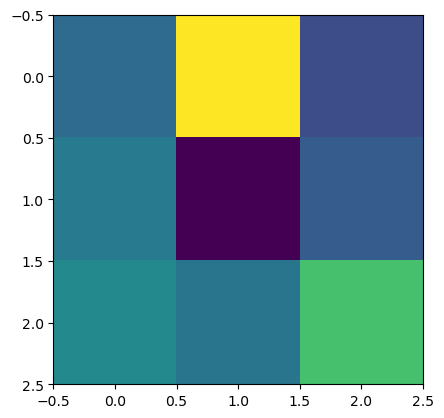

In [527]:
plt.imshow(heatMap)

In [539]:
import matplotlib.pyplot as plt
import numpy as np

def display_gradcam(img, heatmap, alpha=0.6):
    img = plt.imread(img)  # Update this line if your original image needs different handling

    # Resize the heatmap to match the size of the original image
    heatmap = np.uint8(255 * heatmap)  # Scale heatmap to a range 0-255
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)  # Apply a color map

    # Superimpose the heatmap on original image
    superimposed_img = heatmap * alpha + img
    superimposed_img = np.clip(superimposed_img, 0, 255)  # Clip values to ensure they're all between 0 and 255
    superimposed_img = np.uint8(superimposed_img)  # Convert to uint8

    # Display using matplotlib
    plt.figure(figsize=(3,3))
    plt.imshow(superimposed_img)
    plt.axis('off')
    plt.show()

Predictions: tf.Tensor([[0.9536171 0.0463829]], shape=(1, 2), dtype=float32)
Gradients: tf.Tensor(
[[[[ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]]

  [[ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]]

  [[ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]
   [ 0.00491461 -0.00491461]]]], shape=(1, 3, 3, 2), dtype=float32)
Pooled Gradients: tf.Tensor([ 0.00491461 -0.00491461], shape=(2,), dtype=float32)
Heatmap before normalization: tf.Tensor(
[[ 0.02379443  0.06829864  0.01618296]
 [ 0.02844072 -0.12984319  0.01995398]
 [ 0.03201893  0.02647426  0.04840584]], shape=(3, 3), dtype=float32)


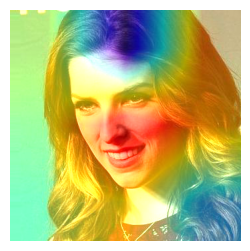

In [540]:
# Usage example
img_path = image_4
heatmap = make_gradcam_heatmap(x1, gender_model, 'conv2d_9')
display_gradcam(img_path, heatMap)

<br></br>
<h3>Emotion Recognition:</h3>

In [549]:
from PIL import Image

In [544]:
model_emotion = load_model('./face_classification/trained_models/emotion_models/fer2013_mini_XCEPTION.102-0.66.hdf5')
model_emotion.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 64, 64, 1)]  0           []                               
                                                                                                  
 conv2d_1 (Conv2D)              (None, 62, 62, 8)    72          ['input_1[0][0]']                
                                                                                                  
 batch_normalization_1 (BatchNo  (None, 62, 62, 8)   32          ['conv2d_1[0][0]']               
 rmalization)                                                                                     
                                                                                                  
 activation_1 (Activation)      (None, 62, 62, 8)    0           ['batch_normalization_1[0][

                                                                                                  
 max_pooling2d_3 (MaxPooling2D)  (None, 8, 8, 64)    0           ['batch_normalization_11[0][0]'] 
                                                                                                  
 batch_normalization_9 (BatchNo  (None, 8, 8, 64)    256         ['conv2d_5[0][0]']               
 rmalization)                                                                                     
                                                                                                  
 add_3 (Add)                    (None, 8, 8, 64)     0           ['max_pooling2d_3[0][0]',        
                                                                  'batch_normalization_9[0][0]']  
                                                                                                  
 separable_conv2d_7 (SeparableC  (None, 8, 8, 128)   8768        ['add_3[0][0]']                  
 onv2D)   

In [579]:
# Load and preprocess the image
def load_and_preprocess_image(image_path):
    img = Image.open(image_path)
    img = img.resize((64, 64))  # Resize the image to 48x48
    img = img.convert('L')  # Convert to grayscale if your model expects grayscale input
    img_array = np.array(img)
    img_array = img_array / 255.0  # Normalize pixel values if necessary
    img_array = img_array.reshape(1, 64, 64, 1)  # Reshape for the model, assuming channel last
    return img_array, img

In [580]:
# Define emotion labels
emotion_labels = {
    0: 'Angry', 
    1: 'Disgust', 
    2: 'Fear', 
    3: 'Happy', 
    4: 'Sad', 
    5: 'Surprise', 
    6: 'Neutral'
}

In [581]:
image_directory = './face_classification/datasets/wiki_crop/Emotion'

1/1 [==============================] - 0s 73ms/step


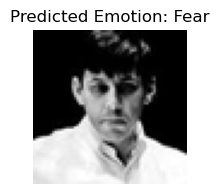

1/1 [==============================] - 0s 57ms/step


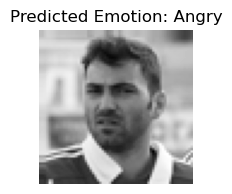

1/1 [==============================] - 0s 51ms/step


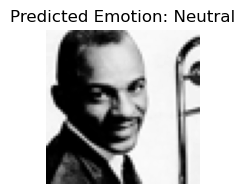

1/1 [==============================] - 0s 50ms/step


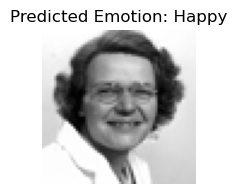

1/1 [==============================] - 0s 55ms/step


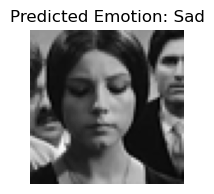

1/1 [==============================] - 0s 59ms/step


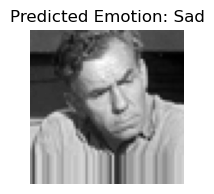

1/1 [==============================] - 0s 59ms/step


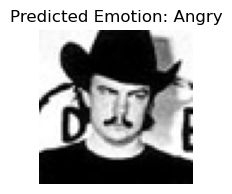

1/1 [==============================] - 0s 55ms/step


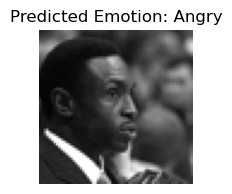

1/1 [==============================] - 0s 65ms/step


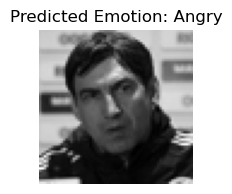

1/1 [==============================] - 0s 65ms/step


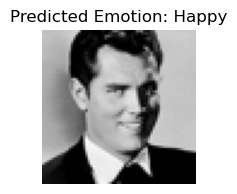

1/1 [==============================] - 0s 67ms/step


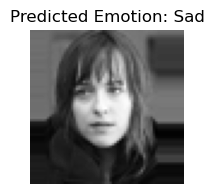

1/1 [==============================] - 0s 37ms/step


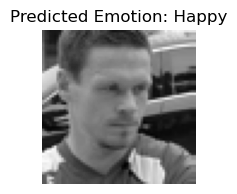

1/1 [==============================] - 0s 57ms/step


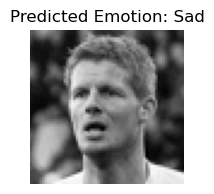

In [583]:
# Process each image in the directory
for filename in os.listdir(image_directory):
    if filename.endswith(".jpg"):  # Assuming the images are in JPG format
        image_path = os.path.join(image_directory, filename)
        image_array, img = load_and_preprocess_image(image_path)
        predictions = model.predict(image_array)
        predicted_emotion = emotion_labels[np.argmax(predictions)]
        
        # Display the image with the predicted label
        plt.figure(figsize= (2,2))
        plt.imshow(img, cmap='gray')  # Show the grayscale image
        plt.title(f"Predicted Emotion: {predicted_emotion}")
        plt.axis('off')  # Hide axes
        plt.show()

<h3>Grad CAM</h3>

In [271]:
import cv2
import h5py
import numpy as np
import keras.backend as K
import pandas as pd
from keras.models import load_model
from keras.layers import Lambda
from keras.models import Sequential
from tensorflow.keras.preprocessing.image import img_to_array, load_img

In [295]:
def process_dataset(model_filename, dataset_filename):
    images, labels = load_data(dataset_filename)
    model = load_model(model_filename, compile=False)
    model = replace_relu_with_guided_relu(model)
    
    # Iterate over images and labels
    for i, image in enumerate(images):
        preprocessed_input = np.expand_dims(image, axis=0)
        predictions = model.predict(preprocessed_input)
        predicted_class = np.argmax(predictions)
        
        gradient_function = compile_gradient_function(
            model, predicted_class, 'conv2d_6')
        register_gradient()
        guided_model = modify_backprop(model, 'GuidedBackProp')
        saliency_function = compile_saliency_function(guided_model)
        
        guided_gradCAM = calculate_guided_gradient_CAM(
            preprocessed_input, gradient_function, saliency_function)
        
        # Save the Grad-CAM output
        cv2.imwrite(f'guided_gradCAM_{i}.jpg', guided_gradCAM)

        # Optionally, display the image or process it further
        print(f'Processed image {i+1}/{len(images)}')

In [596]:
data.head()

,emotion,pixels,Usage
0,0,70 80 82 72 58 58 60 63 54 58 60 48 89 115 121...,Training
1,0,151 150 147 155 148 133 111 140 170 174 182 15...,Training
2,2,231 212 156 164 174 138 161 173 182 200 106 38...,Training
3,4,24 32 36 30 32 23 19 20 30 41 21 22 32 34 21 1...,Training
4,6,4 0 0 0 0 0 0 0 0 0 0 0 3 15 23 28 48 50 58 84...,Training


In [597]:
df = data.drop(['emotion', 'Usage'], axis = 1)

In [599]:
df

(35887, 1)

In [620]:
emotion_labels

{0: 'Angry',
 1: 'Disgust',
 2: 'Fear',
 3: 'Happy',
 4: 'Sad',
 5: 'Surprise',
 6: 'Neutral'}

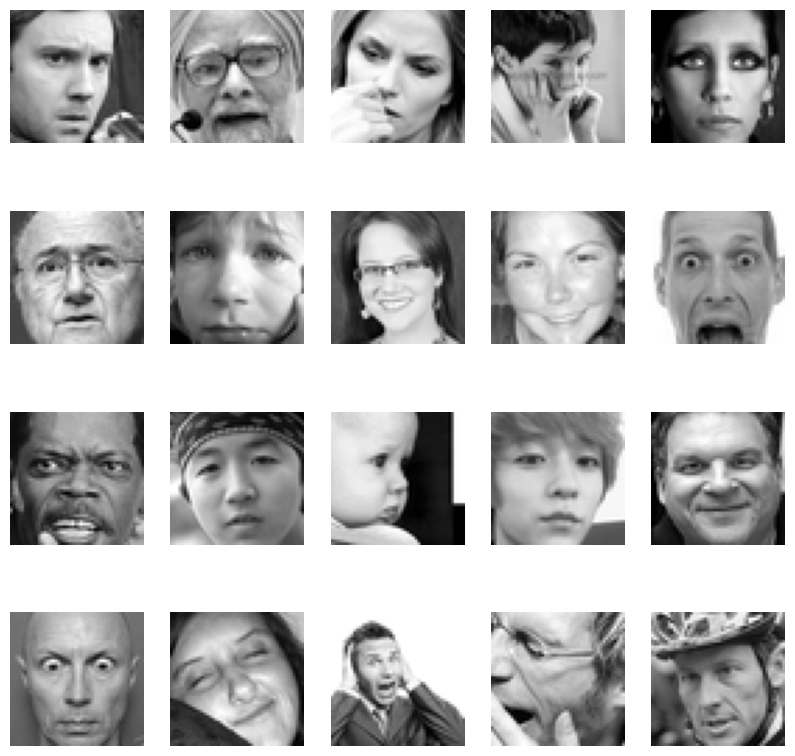

In [617]:
def display_images(data, num_images=20):
    # Setting up 5 rows, 2 images per row
    fig, axes = plt.subplots(4, 5, figsize=(10,10))
    axes = axes.flatten()  # Flatten the 2D array of axes to 1D
    for i, ax in enumerate(axes):
        if i < num_images:
            # Split the string by spaces and convert to numpy array of integers
            pixel_array = np.array(data.iloc[i, 0].split(), dtype='uint8')
            # Reshape the array to 48x48 pixels
            image = pixel_array.reshape(48, 48)
            ax.imshow(image, cmap='gray')
            ax.axis('off')
        else:
            ax.axis('off')  # Turn off axes for any unused subplots
    plt.show()

display_images(df)

In [619]:
emotion_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_array (Conv2D)        (None, 48, 48, 16)        800       
                                                                 
 batch_normalization_1 (Batc  (None, 48, 48, 16)       64        
 hNormalization)                                                 
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 16)        12560     
                                                                 
 batch_normalization_2 (Batc  (None, 48, 48, 16)       64        
 hNormalization)                                                 
                                                                 
 activation_1 (Activation)   (None, 48, 48, 16)        0         
                                                                 
 average_pooling2d_1 (Averag  (None, 24, 24, 16)       0

In [621]:
def preprocess_pixels(pixel_str):
    pixel_array = np.array(pixel_str.split(), dtype='float32')
    return pixel_array.reshape(48, 48, 1) / 255.0 

1/1 [==============================] - 0s 73ms/step


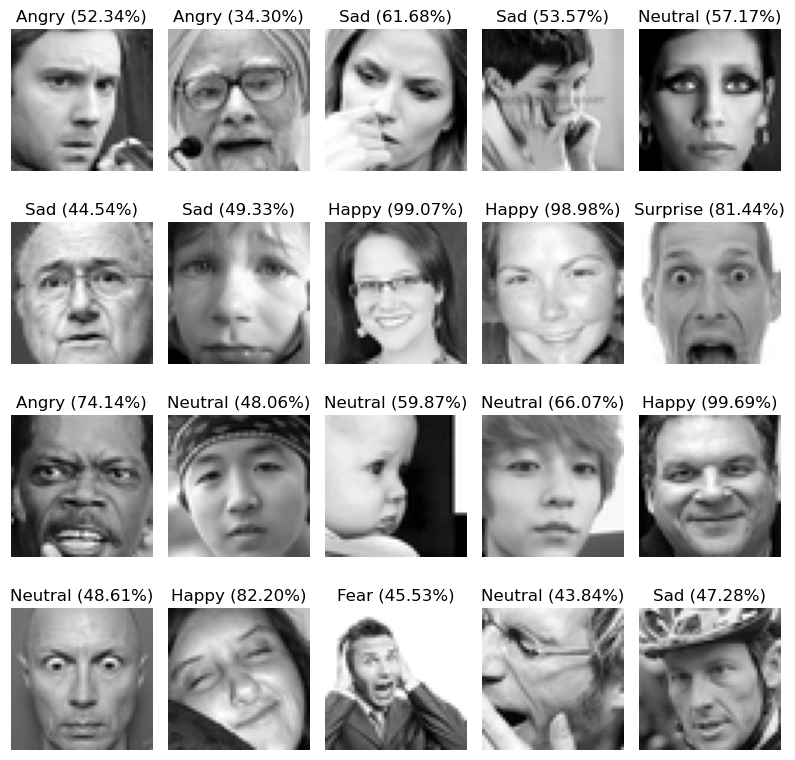

In [626]:
def display_images_with_predictions(data, num_images=20):
    fig, axes = plt.subplots(4, 5, figsize=(8, 8))  
    axes = axes.flatten()
    
    for i, ax in enumerate(axes):
        if i < num_images:
            pixel_str = data.iloc[i, 0]
            image_array = preprocess_pixels(pixel_str)
            image_array_expanded = np.expand_dims(image_array, axis=0)  # Expand dimensions to match model input expectations

            # Predict emotion
            predictions = emotion_model.predict(image_array_expanded)
            predicted_label_index = np.argmax(predictions)
            predicted_label = emotion_labels[predicted_label_index]
            confidence_score = np.max(predictions) * 100  # Percentage confidence
            
            # Display image
            ax.imshow(image_array.squeeze(), cmap='gray')  # Squeeze to remove single-dimensional entries from array shape
            ax.axis('off')
            ax.set_title(f"{predicted_label} ({confidence_score:.2f}%)")
        else:
            ax.axis('off')
    
    plt.tight_layout()
    plt.show()

display_images_with_predictions(df)

In [627]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image

In [686]:
def preprocess_pixels_grad(pixel_str):
    # Convert the pixel string to a numpy array of type float32
    pixel_array = np.array(pixel_str.split(), dtype='float32')
    # Normalize the pixel values to the range [0, 1] (if your model was trained this way)
    # Reshape the array to the required shape (48x48x1) if the model expects single channel
    image_array = pixel_array.reshape(48, 48, 1) / 255.0
    # Expand dimensions to add the batch size as 1
    img_array = np.expand_dims(image_array, axis=0)
    return img_array

# Example pixel string from your DataFrame
pixel_str = df.iloc[1, 0]  # Assuming the first image

# Preprocess the image
img_array_grad = preprocess_pixels_grad(pixel_str)

In [687]:
img_array_grad

array([[[[0.5921569 ],
         [0.5882353 ],
         [0.5764706 ],
         ...,
         [0.5058824 ],
         [0.54901963],
         [0.47058824]],

        [[0.5921569 ],
         [0.58431375],
         [0.58431375],
         ...,
         [0.47843137],
         [0.5529412 ],
         [0.5372549 ]],

        [[0.5921569 ],
         [0.5921569 ],
         [0.6117647 ],
         ...,
         [0.42745098],
         [0.48235294],
         [0.57254905]],

        ...,

        [[0.7372549 ],
         [0.7372549 ],
         [0.4745098 ],
         ...,
         [0.7254902 ],
         [0.7254902 ],
         [0.7294118 ]],

        [[0.7372549 ],
         [0.73333335],
         [0.76862746],
         ...,
         [0.7294118 ],
         [0.7137255 ],
         [0.73333335]],

        [[0.7294118 ],
         [0.72156864],
         [0.7254902 ],
         ...,
         [0.75686276],
         [0.7176471 ],
         [0.72156864]]]], dtype=float32)

In [688]:
heatmap_emotion = make_gradcam_heatmap(img_array_grad, emotion_model, 'conv2d_9')

Predictions: tf.Tensor(
[[0.34302828 0.00683227 0.20547172 0.03761695 0.26334178 0.06067135
  0.08303764]], shape=(1, 7), dtype=float32)
Gradients: tf.Tensor(
[[[[ 0.02503999 -0.00026041 -0.0078314  -0.00143374 -0.01003708
    -0.00231244 -0.00316492]
   [ 0.02503999 -0.00026041 -0.0078314  -0.00143374 -0.01003708
    -0.00231244 -0.00316492]
   [ 0.02503999 -0.00026041 -0.0078314  -0.00143374 -0.01003708
    -0.00231244 -0.00316492]]

  [[ 0.02503999 -0.00026041 -0.0078314  -0.00143374 -0.01003708
    -0.00231244 -0.00316492]
   [ 0.02503999 -0.00026041 -0.0078314  -0.00143374 -0.01003708
    -0.00231244 -0.00316492]
   [ 0.02503999 -0.00026041 -0.0078314  -0.00143374 -0.01003708
    -0.00231244 -0.00316492]]

  [[ 0.02503999 -0.00026041 -0.0078314  -0.00143374 -0.01003708
    -0.00231244 -0.00316492]
   [ 0.02503999 -0.00026041 -0.0078314  -0.00143374 -0.01003708
    -0.00231244 -0.00316492]
   [ 0.02503999 -0.00026041 -0.0078314  -0.00143374 -0.01003708
    -0.00231244 -0.00316492]]

In [695]:
def display_gradcam_gray(img, heatmap, alpha=0.6):
    # Ensure the image is grayscale and has shape (48, 48)
    if img.ndim == 3 and img.shape[2] == 1:
        img = img.squeeze()  # Squeeze to (48, 48) if (48, 48, 1)

    # Convert grayscale image to RGB
    img_rgb = np.stack((img,)*3, axis=-1)

    # Resize the heatmap to match the size of the original image and apply a colormap
    heatmap = np.uint8(255 * heatmap)  # Scale to 0-255
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))  # Resize heatmap
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)  # Apply color map

    # Create the superimposed image by combining the color heatmap with the grayscale image
    superimposed_img = heatmap * alpha + img_rgb
    superimposed_img = np.clip(superimposed_img, 0, 255).astype('uint8')  # Clip values to ensure valid pixel range

    # Display the original and superimposed image for comparison
    plt.figure(figsize=(5, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    plt.title('Original Grayscale Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(superimposed_img)
    plt.title('Grad-CAM')
    plt.axis('off')
    plt.show()

In [693]:
print("Heatmap shape:", heatmap.shape)

Heatmap shape: (3,)


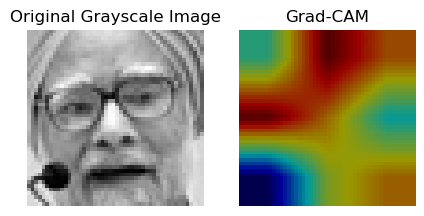

In [696]:
img = preprocess_pixels_grad(df.iloc[1, 0])
display_gradcam_gray(img.squeeze(), heatmap_emotion)

**This Grad CAM technique is not giving clear explanations**

<br></br>
<h3>Let's try Guided Grad-CAM with Backpropagation</h3>

In [774]:
import cv2
import h5py
import keras
import keras.backend as K
from keras.layers.core import Lambda
from keras.models import Sequential
from keras.models import load_model
import numpy as np
import tensorflow as tf
from tensorflow.python.framework import ops

In [775]:
def reset_optimizer_weights(model_filename):
    model = h5py.File(model_filename, 'r+')
    del model['optimizer_weights']
    model.close()

In [776]:
def target_category_loss(x, category_index, num_classes):
    return tf.multiply(x, K.one_hot([category_index], num_classes))

In [777]:
def target_category_loss_output_shape(input_shape):
    return input_shape

In [778]:
def normalize(x):
    # utility function to normalize a tensor by its L2 norm
    return x / (K.sqrt(K.mean(K.square(x))) + 1e-5)

In [779]:
def load_image(image_array):
    image_array = np.expand_dims(image_array, axis=0)
    image_array = preprocess_input(image_array)
    return image_array

In [780]:
def register_gradient():
    if "GuidedBackProp" not in ops._gradient_registry._registry:
        @ops.RegisterGradient("GuidedBackProp")
        def _GuidedBackProp(op, gradient):
            dtype = op.inputs[0].dtype
            guided_gradient = (gradient * tf.cast(gradient > 0., dtype) *
                               tf.cast(op.inputs[0] > 0., dtype))
            return guided_gradient

In [781]:
# def compile_saliency_function(model, activation_layer='conv2d_7'):
#     input_image = model.input
#     layer_output = model.get_layer(activation_layer).output
#     max_output = K.max(layer_output, axis=3)
#     saliency = K.gradients(K.sum(max_output), input_image)[0]
#     return K.function([input_image, K.learning_phase()], [saliency])

def compile_saliency_function(model, activation_layer='conv2d_7'):
    def saliency_function(input_image):
        input_image_tensor = tf.convert_to_tensor(input_image)
        with tf.GradientTape() as tape:
            tape.watch(input_image_tensor)
            predictions = model(input_image_tensor)
            # We choose the class with the maximum prediction value as the target class
            target_class_idx = tf.argmax(predictions[0])
            target_class_output = predictions[:, target_class_idx]

        # Compute the gradient of the target class output with respect to the input image
        gradients = tape.gradient(target_class_output, input_image_tensor)
        # Apply post-processing if needed (like taking absolute values, smoothing, etc.)
        saliency_map = tf.abs(gradients)
        return saliency_map
    
    return saliency_function

In [782]:
from tensorflow.keras.utils import register_keras_serializable

@register_keras_serializable(package='Custom', name='guided_relu')
def guided_relu(x):
    return tf.where(x > 0., x, tf.zeros_like(x))

def modify_backprop(model):
    # Get all layers, check for activation and replace if necessary
    for layer in model.layers:
        if hasattr(layer, 'activation') and layer.activation == tf.keras.activations.relu:
            # Replace ReLU with custom guided ReLU
            layer.activation = guided_relu

    # Rebuild model with replaced activations
    new_model = tf.keras.models.clone_model(model, clone_function=lambda l: l)
    new_model.set_weights(model.get_weights())
    return new_model

# class GuidedReLU(tf.keras.layers.Layer):
#     def __init__(self):
#         super(GuidedReLU, self).__init__()

#     def call(self, inputs):
#         return tf.where(inputs > 0, inputs, tf.zeros_like(inputs))

# def replace_relu_with_guided(model):
#     # Traverse all layers and replace ReLU with GuidedReLU
#     for layer in model.layers:
#         if hasattr(layer, 'activation') and layer.activation == tf.keras.activations.relu:
#             layer.activation = GuidedReLU()

#     # Rebuild model architecture with modified activations
#     model = tf.keras.models.clone_model(model)
#     model.set_weights(model.get_weights())  # Reapply the weights to the new model
#     return model

In [784]:
def deprocess_image(x):
    if np.ndim(x) > 3:
        x = np.squeeze(x)
    # normalize tensor: center on 0., ensure std is 0.1
    x = x - x.mean()
    x = x / (x.std() + 1e-5)
    x = x * 0.1

    # clip to [0, 1]
    x = x + 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x = x * 255
    if K.image_dim_ordering() == 'th':
        x = x.transpose((1, 2, 0))
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [785]:
# def compile_gradient_function(input_model, category_index, layer_name):
#     model = Sequential()
#     model.add(input_model)

#     num_classes = model.output_shape[1]
#     target_layer = lambda x: target_category_loss(x, category_index, num_classes)
#     model.add(Lambda(target_layer,
#                      output_shape=target_category_loss_output_shape))

#     loss = K.sum(model.layers[-1].output)
#     conv_output = model.layers[0].get_layer(layer_name).output
#     gradients = normalize(K.gradients(loss, conv_output)[0])
#     gradient_function = K.function([model.layers[0].input, K.learning_phase()],
#                                    [conv_output, gradients])
#     return gradient_function


def compile_gradient_function(input_model, category_index, layer_name):
    # Create a new model that outputs both the original model's predictions and the outputs of the specified layer
    layer_output = input_model.get_layer(layer_name).output
    model = tf.keras.Model(inputs=input_model.inputs, outputs=[input_model.output, layer_output])

    def gradient_function(input_data):
        with tf.GradientTape() as tape:
            tape.watch(input_data)
            predictions, layer_outputs = model(input_data)
            loss = tf.reduce_sum(predictions[:, category_index])  # Assuming using categorical indices

        # Get gradients of loss with respect to the layer outputs
        grads = tape.gradient(loss, layer_outputs)
        return layer_outputs, grads

    return gradient_function

In [786]:
def calculate_gradient_weighted_CAM(gradient_function, image):
    # Convert the image to a tensor if it's not already
    if not isinstance(image, tf.Tensor):
        image = tf.convert_to_tensor(image, dtype=tf.float32)
    
    output, evaluated_gradients = gradient_function(image)
    output = output.numpy()  # Assuming you need to work with numpy array downstream
    evaluated_gradients = evaluated_gradients.numpy()
    
    # Check shapes and dimensions for debugging
    print("Output shape:", output.shape)
    print("Evaluated gradients shape:", evaluated_gradients.shape)
    
    # Averaging over the spatial dimensions (0, 1) of the gradients to get the importance of channels
    weights = np.mean(evaluated_gradients, axis=(0, 1))
    
    # Initialize a CAM of the same spatial dimensions as the output of the layer
    CAM = np.zeros(output.shape[0:2], dtype=np.float32)
    
    # Weighted sum of the forward activation maps
    for i, weight in enumerate(weights):
        CAM += weight * output[:, :, i]
    
    # Resize the CAM to the size of the input image to overlay it correctly
    CAM = cv2.resize(CAM, (48, 48))  # Resize the CAM to match the input image size
    CAM = np.maximum(CAM, 0)  # ReLU to ensure that only positive influences are visualized
    heatmap = CAM / np.max(CAM)  # Normalize to [0, 1] to create a heatmap
    
    return CAM, heatmap

In [787]:
def calculate_guided_gradient_CAM(preprocessed_input, gradient_function, saliency_function):
    CAM, heatmap = calculate_gradient_weighted_CAM(gradient_function, preprocessed_input)
    saliency = saliency_function(preprocessed_input)  # Assuming saliency_function expects a tensor
    saliency = np.array(saliency)  # Convert to numpy array if needed
    gradCAM = saliency * np.expand_dims(heatmap, axis=-1)  # Assuming saliency is a single channel
    return deprocess_image(gradCAM)

In [788]:
def calculate_guided_gradient_CAM_v2(
        preprocessed_input, gradient_function,
        saliency_function, target_size=(128, 128)):
    CAM, heatmap = calculate_gradient_weighted_CAM(
            gradient_function, preprocessed_input)
    heatmap = np.squeeze(heatmap)
    heatmap = cv2.resize(heatmap.astype('uint8'), target_size)
    saliency = saliency_function([preprocessed_input, 0])
    saliency = np.squeeze(saliency[0])
    saliency = cv2.resize(saliency.astype('uint8'), target_size)
    gradCAM = saliency * heatmap
    gradCAM = deprocess_image(gradCAM)
    return np.expand_dims(gradCAM, -1)

In [790]:
model_filename = './face_classification/trained_models/emotion_models/simple_CNN.985-0.66.hdf5'
model_e = load_model(model_filename)

In [791]:
def preprocess_input(x, v2=True):
    x = x.astype('float32')
    x = x / 255.0
    if v2:
        x = x - 0.5
        x = x * 2.0
    return x

In [ ]:
# reset_optimizer_weights(model_filename)

preprocessed_input = load_image(image)
predictions = emotion_model.predict(preprocessed_input)
predicted_class = np.argmax(predictions)
gradient_function = compile_gradient_function(emotion_model, predicted_class, 'conv2d_8')
register_gradient()
guided_model = modify_backprop(emotion_model)
with tf.keras.utils.custom_object_scope({'guided_relu': guided_relu}):
    guided_model = modify_backprop(emotion_model)
saliency_function = compile_saliency_function(guided_model)
guided_gradCAM = calculate_guided_gradient_CAM(preprocessed_input, gradient_function, saliency_function)

cv2.imwrite('guided_gradCAM.jpg', guided_gradCAM)